# Churn prediction

In [58]:
import os
import mlflow
import pandas as pd
from databricks import sql
mlflow.set_tracking_uri("http://host.docker.internal:5000")

In [59]:
database = "olist_dataset"
goldSche=database+ ".gold"
lookupGeo=database+".silver"+ ".silver_olist_geolocation"
lookupCateName=database+".silver"+ ".silver_product_category_name_translation"


In [60]:

connection = sql.connect(
                        server_hostname = "dbc-214ffec4-c1f2.cloud.databricks.com",
                        http_path = "/sql/1.0/warehouses/8753fa7395d762fe",
                        access_token = os.environ.get("DATABRICKS_TOKEN"))




In [61]:
df = pd.read_sql(
    f"""
    SELECT 
        customer_key,
        COUNT(DISTINCT product_category_name) AS distinct_categories,
        COUNT(DISTINCT product_key) AS distinct_products,
        COUNT(DISTINCT seller_key) AS distinct_sellers,
        -- Chỉ số tập trung Herfindahl: sum(p_i^2)
        SUM(POWER(category_ratio, 2)) AS category_concentration
    FROM (
        SELECT 
            oi.customer_key,
            p.product_category_name,
            oi.product_key,
            oi.seller_key,
            -- Tính tỷ lệ category i trong tổng số đơn hàng của customer
            COUNT(*) * 1.0 / SUM(COUNT(*)) OVER (PARTITION BY oi.customer_key) AS category_ratio
        FROM {goldSche}.fact_order_items oi
        JOIN {goldSche}.dim_olist_products p 
            ON oi.product_key = p.product_key
        GROUP BY oi.customer_key, p.product_category_name, oi.product_key, oi.seller_key
    ) t
    
    GROUP BY customer_key
"""
    , connection)
df.head(20)
df.info()
df.describe()

/tmp/ipykernel_2850/1702896046.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94108 entries, 0 to 94107
Data columns (total 5 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   customer_key            94108 non-null  int64  
 1   distinct_categories     94108 non-null  int64  
 2   distinct_products       94108 non-null  int64  
 3   distinct_sellers        94108 non-null  int64  
 4   category_concentration  94108 non-null  float64
dtypes: float64(1), int64(4)
memory usage: 3.6 MB


,customer_key,distinct_categories,distinct_products,distinct_sellers,category_concentration
count,94108.000000,94108.000000,94108.000000,94108.000000,94108.000000
mean,48070.817837,1.025099,1.068241,1.037499,0.970468
std,27761.631854,0.168020,0.314595,0.215113,0.121499
min,1.000000,1.000000,1.000000,1.000000,0.075556
25%,24034.750000,1.000000,1.000000,1.000000,1.000000
50%,48068.500000,1.000000,1.000000,1.000000,1.000000
75%,72084.250000,1.000000,1.000000,1.000000,1.000000
max,97376.000000,5.000000,14.000000,10.000000,1.000000


In [62]:
df = pd.read_sql(
    f"""
    SELECT c.customer_key,
           fi.product_key,
           COUNT(*) AS cnt,
           ROW_NUMBER() OVER (PARTITION BY c.customer_key ORDER BY COUNT(*) DESC) AS rn
    FROM {goldSche}.fact_order_items fi
    JOIN {goldSche}.dim_olist_customers c ON fi.customer_key = c.customer_key AND c.is_current=true
    GROUP BY c.customer_key, fi.product_key
"""
    , connection)
df.head(20)
df.info()
df.describe()

/tmp/ipykernel_2850/3293674944.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101428 entries, 0 to 101427
Data columns (total 4 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   customer_key  101428 non-null  int64  
 1   product_key   99983 non-null   float64
 2   cnt           101428 non-null  int64  
 3   rn            101428 non-null  int64  
dtypes: float64(1), int64(3)
memory usage: 3.1 MB


,customer_key,product_key,cnt,rn
count,101428.000000,99983.000000,101428.000000,101428.000000
mean,49259.783788,16122.822140,1.104281,1.077198
std,28354.127983,9286.015361,0.476632,0.351360
min,1.000000,1.000000,1.000000,1.000000
25%,24682.000000,8177.000000,1.000000,1.000000
50%,49354.500000,15920.000000,1.000000,1.000000
75%,73975.250000,24219.000000,1.000000,1.000000
max,96096.000000,32341.000000,24.000000,15.000000


In [63]:
df = pd.read_sql(
    f"""
    SELECT tp.customer_key,
           p.product_weight_g AS top_product_weight,
           p.product_length_cm AS top_product_length,
           p.product_height_cm AS top_product_height,
           p.product_width_cm  AS top_product_width
    FROM (
        SELECT c.customer_key,
           fi.product_key,
           COUNT(*) AS cnt,
           ROW_NUMBER() OVER (PARTITION BY c.customer_key ORDER BY COUNT(*) DESC) AS rn
        FROM {goldSche}.fact_order_items fi
        JOIN {goldSche}.dim_olist_customers c ON fi.customer_key = c.customer_key AND c.is_current=true
    GROUP BY c.customer_key, fi.product_key
    ) tp
    JOIN {goldSche}.dim_olist_products p ON tp.product_key = p.product_key
    WHERE tp.rn = 1
"""
    , connection)
df.head(20)
df.info()
df.describe()

/tmp/ipykernel_2850/2922194075.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93800 entries, 0 to 93799
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_key        93800 non-null  int64  
 1   top_product_weight  93799 non-null  float64
 2   top_product_length  93799 non-null  float64
 3   top_product_height  93799 non-null  float64
 4   top_product_width   93799 non-null  float64
dtypes: float64(4), int64(1)
memory usage: 3.6 MB


,customer_key,top_product_weight,top_product_length,top_product_height,top_product_width
count,93800.000000,93799.000000,93799.000000,93799.000000,93799.000000
mean,47924.797857,2109.720935,30.142752,16.541178,23.048721
std,27673.181854,3767.747163,16.147615,13.369898,11.739237
min,1.000000,0.000000,7.000000,2.000000,6.000000
25%,23965.750000,300.000000,18.000000,8.000000,15.000000
50%,47926.500000,700.000000,25.000000,13.000000,20.000000
75%,71870.250000,1814.000000,38.000000,20.000000,30.000000
max,96096.000000,40425.000000,105.000000,105.000000,118.000000


In [64]:
df = pd.read_sql(
    f"""
   SELECT customer_key, payment_type AS most_used_payment_type
    FROM (
        SELECT 
            p.customer_key,
            pt.payment_type,
            ROW_NUMBER() OVER (PARTITION BY p.customer_key ORDER BY COUNT(*) DESC) AS rn
        FROM {goldSche}.fact_payments p
        JOIN {goldSche}.dim_olist_payment_type pt 
             ON p.payment_type_key = pt.payment_type_key
        GROUP BY p.customer_key, pt.payment_type
    ) t
    WHERE rn = 1
"""
    , connection)
df.head(20)

/tmp/ipykernel_2850/152597362.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,customer_key,most_used_payment_type
0,1,credit_card
1,2,credit_card
2,3,credit_card
3,4,credit_card
4,5,credit_card
5,6,credit_card
6,7,boleto
7,8,credit_card
8,9,credit_card
9,10,credit_card


In [65]:
df = pd.read_sql(
    f"""

    SELECT 
        r.customer_key,
        SUM(CASE 
                WHEN LENGTH(rc.review_comment_title) > 0 OR LENGTH(rc.review_comment_message) > 0
                THEN 1 ELSE 0 
            END) AS review_with_comment,
        AVG(DATEDIFF(day, d2.full_date, d.full_date)) AS avg_review_response_time
    FROM {goldSche}.fact_reviews r
    JOIN {goldSche}.dim_olist_review_content rc ON r.review_content_key = rc.review_content_key
    JOIN {goldSche}.dim_date d ON r.review_answer_date_key = d.date_key
    JOIN {goldSche}.dim_date d2 ON r.review_creation_date_key = d2.date_key
    GROUP BY r.customer_key


"""
    , connection)
df.head(20)

/tmp/ipykernel_2850/1731964171.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,customer_key,review_with_comment,avg_review_response_time
0,27746,1,0.0
1,58987,1,1.0
2,60701,1,1.0
3,71406,1,3.0
4,34173,1,1.0
5,31289,1,1.0
6,74195,1,4.0
7,66264,0,3.0
8,85267,1,3.0
9,29936,0,0.0


#### Notes: 
Vì bộ data này được tạo khá lâu so với ngày hiện tại nên không thể tính recency dựa trên CURRENT_DATE, 
để xử lí việc này em mới tạo analysis snapshot cte để lấy làm ngày mốc.

In [66]:
query =f"""

WITH analysis_snapshot AS (
    SELECT 
        DATEADD(day, 1, MAX(d.full_date)) AS snapshot_date
    FROM {goldSche}.dim_olist_orders o
    JOIN {goldSche}.dim_date d ON o.order_purchase_date_key = d.date_key
),
--Lấy thông tin về ngày mua hàng và ngày giao hàng thành công cho mỗi đơn hàng.
 order_dates AS ( 
    SELECT 
        o.order_key,
        o.order_id,
        oi.customer_key,
        d_purchase.full_date AS purchase_date,
        d_delivered.full_date AS delivered_date,
        
        -- === TÍNH TOÁN CÁC FEATURE MỚI  ===
        
        -- 1. Số ngày giao trễ so với dự kiến 
        DATEDIFF(day, d_estimated.full_date, d_delivered.full_date) AS delivery_overdue_days,

        -- 2. Cờ đánh dấu đơn hàng giao trễ (1 = trễ, 0 = không trễ)
        CASE 
            WHEN d_delivered.full_date > d_estimated.full_date THEN 1 
            ELSE 0 
        END AS is_delivered_late,

        -- 3. Thời gian xử lý nội bộ (từ lúc duyệt đến lúc giao vận chuyển)
        DATEDIFF(day, d_approved.full_date, d_carrier.full_date) AS internal_processing_days,

        -- 4. Thời gian giao hàng hứa hẹn (từ lúc mua đến ngày giao dự kiến)
        DATEDIFF(day, d_purchase.full_date, d_estimated.full_date) AS promised_window_days,
        
        --5. Khách hàng mua hàng ở thời điểm là holiday
        d_purchase.is_holiday is_purchase_holiday

    FROM {goldSche}.dim_olist_orders o
    JOIN {goldSche}.fact_order_items oi ON oi.order_key = o.order_key
    
    -- Join với bảng Date nhiều lần cho mỗi loại ngày
    JOIN {goldSche}.dim_date d_purchase ON o.order_purchase_date_key = d_purchase.date_key
    LEFT JOIN {goldSche}.dim_date d_delivered ON o.order_delivered_customer_date_key = d_delivered.date_key
    LEFT JOIN {goldSche}.dim_date d_estimated ON o.order_estimated_delivery_date_key = d_estimated.date_key
    LEFT JOIN {goldSche}.dim_date d_approved ON o.order_approved_at_date_key = d_approved.date_key
    LEFT JOIN {goldSche}.dim_date d_carrier ON o.order_delivered_carrier_date_key = d_carrier.date_key

    WHERE o.order_status = 'delivered'
    -- GROUP BY để tránh trùng lặp nếu một đơn hàng có nhiều sản phẩm
    GROUP BY 1, 2, 3, 4, 5, 6, 7, 8, 9,10
),
-- Tính giá trị cho mỗi đơn hàng, và thông tin của chúng
order_values AS (
    SELECT  
            oi.customer_key,
            oi.order_key,
            SUM(oi.price) AS order_price,
            SUM(oi.freight_value) AS order_freight
        FROM {goldSche}.fact_order_items oi
        GROUP BY oi.customer_key, oi.order_key
),


customer_agg AS (
    SELECT 
        od.customer_key,
        -- Recency: ngày hiện tại - ngày mua cuối
        DATEDIFF(day, MAX(od.purchase_date), (SELECT snapshot_date FROM analysis_snapshot)) AS recency_days,
        -- Tenure: ngày mua gần nhất - ngày mua đầu tiên ( thời gian gắn bó)
        DATEDIFF(day, MIN(od.purchase_date), MAX(od.purchase_date)) AS customer_tenure,
        -- Frequency: số lượng đơn
        COUNT(DISTINCT od.order_id) AS frequency_orders,
        -- Monetary: tổng tiền chi tiêu
        SUM(ov.order_price) AS monetary_value,
        -- Average order value
        AVG(ov.order_price) AS avg_order_price,
        -- Tổng freight
        SUM(ov.order_freight) AS sum_freight,
        -- Avg freight
        AVG(ov.order_freight) AS avg_freight,


        -- Aggerate các cột về thời gian.
        AVG(DATEDIFF(day, od.purchase_date, od.delivered_date)) AS avg_delivery_delay,
        AVG(CAST(od.is_delivered_late AS FLOAT)) AS late_delivery_rate,
        AVG(od.delivery_overdue_days) AS avg_delivery_overdue_days,
        AVG(od.internal_processing_days) AS avg_internal_processing_days,
        AVG(od.promised_window_days) AS avg_promised_window_days,

        -- 1. Tỷ lệ mua hàng vào ngày lễ
        AVG(CASE WHEN od.is_purchase_holiday = true THEN 1.0 ELSE 0.0 END) AS holiday_purchase_rate,
        -- 2. Số ngày giao trễ trung bình, tính riêng cho ngày lễ và ngày thường
        AVG(CASE WHEN od.is_purchase_holiday = true THEN od.delivery_overdue_days END) AS avg_overdue_days_on_holidays,
        AVG(CASE WHEN od.is_purchase_holiday = false THEN od.delivery_overdue_days END) AS avg_overdue_days_on_non_holidays


    FROM order_dates od
    JOIN order_values ov ON od.order_key = ov.order_key
    GROUP BY od.customer_key
),

review_agg AS (
    SELECT 
        r.customer_key,
        AVG(r.score) AS avg_review_score
    FROM {goldSche}.fact_reviews r
    GROUP BY r.customer_key
),

payment_agg AS (
    SELECT 
        p.customer_key,
        COUNT(DISTINCT pt.payment_type) AS distinct_payment_methods,
        AVG(p.payment_installments) AS avg_installments
    FROM {goldSche}.fact_payments p
    JOIN {goldSche}.dim_olist_payment_type pt ON p.payment_type_key = pt.payment_type_key
    GROUP BY p.customer_key
),


-- Đa dạng sản phẩm, seller và Herfindahl index
product_diversity AS (
   
    SELECT 
        customer_key,
        COUNT(DISTINCT product_category_name) AS distinct_categories,
        COUNT(DISTINCT product_key) AS distinct_products,
        COUNT(DISTINCT seller_key) AS distinct_sellers,
        -- Chỉ số tập trung Herfindahl: sum(p_i^2)
        SUM(POWER(category_ratio, 2)) AS category_concentration
    FROM (
        SELECT 
            oi.customer_key,
            p.product_category_name,
            oi.product_key,
            oi.seller_key,
            -- Tính tỷ lệ category i trong tổng số đơn hàng của customer
            COUNT(*) * 1.0 / SUM(COUNT(*)) OVER (PARTITION BY oi.customer_key) AS category_ratio
        FROM {goldSche}.fact_order_items oi
        JOIN {goldSche}.dim_olist_products p 
            ON oi.product_key = p.product_key
        GROUP BY oi.customer_key, p.product_category_name, oi.product_key, oi.seller_key
    ) t
    
    GROUP BY customer_key
),

-- Sản phẩm được mua nhiều nhất của mỗi khách hàng
top_product AS (
    SELECT customer_key, product_key AS most_purchased_product
    FROM (
        SELECT 
            oi.customer_key,
            oi.product_key,
            ROW_NUMBER() OVER (PARTITION BY oi.customer_key ORDER BY COUNT(*) DESC) AS rn
        FROM {goldSche}.fact_order_items oi
        GROUP BY oi.customer_key, oi.product_key
    ) t
    WHERE rn = 1
),

-- Payment type phổ biến nhất
top_payment AS (
    SELECT customer_key, payment_type AS most_used_payment_type
    FROM (
        SELECT 
            p.customer_key,
            pt.payment_type,
            ROW_NUMBER() OVER (PARTITION BY p.customer_key ORDER BY COUNT(*) DESC) AS rn
        FROM {goldSche}.fact_payments p
        JOIN {goldSche}.dim_olist_payment_type pt 
             ON p.payment_type_key = pt.payment_type_key
        GROUP BY p.customer_key, pt.payment_type
    ) t
    WHERE rn = 1
),

-- Review: có comment & thời gian phản hồi
review_detail AS (
    SELECT 
        r.customer_key,
        SUM(CASE 
                WHEN LENGTH(rc.review_comment_title) > 0 
                  OR LENGTH(rc.review_comment_message) > 0
                THEN 1 ELSE 0 
            END) AS review_with_comment,
        AVG(DATEDIFF(day, d2.full_date, d.full_date)) AS avg_review_response_time
    FROM {goldSche}.fact_reviews r
    JOIN {goldSche}.dim_olist_review_content rc 
         ON r.review_content_key = rc.review_content_key
    JOIN {goldSche}.dim_date d 
         ON r.review_answer_date_key = d.date_key
    JOIN {goldSche}.dim_date d2 
         ON r.review_creation_date_key = d2.date_key
    GROUP BY r.customer_key
)


SELECT 
    c.customer_key,
    ca.recency_days,
    ca.customer_tenure,
    ca.frequency_orders,
    ca.monetary_value,
    ca.avg_order_price,
    ca.sum_freight,
    ca.avg_freight,



    -- Các feature mới về thời gian và hiệu suất giao hàng
    ca.avg_delivery_delay,
    ca.late_delivery_rate,
    ca.avg_delivery_overdue_days,
    ca.avg_internal_processing_days,
    ca.avg_promised_window_days,

    -- Các feature mới về ngày lễ (holidays)
    ca.holiday_purchase_rate,
    ca.avg_overdue_days_on_holidays,
    ca.avg_overdue_days_on_non_holidays,


    -- Các feature từ CTE khác
    ra.avg_review_score,
    pa.distinct_payment_methods,
    pa.avg_installments,



    -- VEERRSION 2
    pd.distinct_categories,
    pd.distinct_products,
    pd.distinct_sellers,
    pd.category_concentration,
    tp.most_purchased_product,
    tpay.most_used_payment_type,
    rd.review_with_comment,
    rd.avg_review_response_time,


    -- === THÊM CHURN LABEL  ===
    CASE 
        WHEN ca.recency_days > 180 THEN 1 
        ELSE 0 
    END AS churn_label
    
FROM customer_agg ca
LEFT JOIN review_agg ra ON ca.customer_key = ra.customer_key
LEFT JOIN payment_agg pa ON ca.customer_key = pa.customer_key

-- ver
LEFT JOIN product_diversity pd ON ca.customer_key = pd.customer_key
LEFT JOIN top_product tp ON ca.customer_key = tp.customer_key
LEFT JOIN top_payment tpay ON ca.customer_key = tpay.customer_key
LEFT JOIN review_detail rd ON ca.customer_key = rd.customer_key

JOIN {goldSche}.dim_olist_customers c ON ca.customer_key = c.customer_key AND c.is_current=true;

"""
df=pd.read_sql(query ,connection)
df.head()

/tmp/ipykernel_2850/3926250787.py:261: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df=pd.read_sql(query ,connection)


,customer_key,recency_days,customer_tenure,frequency_orders,monetary_value,avg_order_price,sum_freight,avg_freight,avg_delivery_delay,late_delivery_rate,...,avg_installments,distinct_categories,distinct_products,distinct_sellers,category_concentration,most_purchased_product,most_used_payment_type,review_with_comment,avg_review_response_time,churn_label
0,63412,211,0,1,69.88,69.88,23.07,23.07,8.0,0.0,...,2.0,1.0,1.0,1.0,1.0,21345.0,credit_card,1.0,0.0,1
1,31522,162,0,1,18.90,18.90,7.55,7.55,5.0,0.0,...,1.0,1.0,1.0,1.0,1.0,8858.0,boleto,0.0,1.0,0
2,89729,105,0,1,49.80,49.80,14.86,14.86,2.0,0.0,...,1.0,1.0,1.0,1.0,1.0,12598.0,credit_card,1.0,2.0,0
3,81335,232,0,1,89.99,89.99,31.38,31.38,11.0,0.0,...,1.0,1.0,1.0,1.0,1.0,1053.0,boleto,0.0,0.0,1
4,2968,441,0,1,47.49,47.49,16.60,16.60,8.0,0.0,...,1.0,1.0,1.0,1.0,1.0,6853.0,boleto,0.0,3.0,1


In [67]:
df.describe()

,customer_key,recency_days,customer_tenure,frequency_orders,monetary_value,avg_order_price,sum_freight,avg_freight,avg_delivery_delay,late_delivery_rate,...,distinct_payment_methods,avg_installments,distinct_categories,distinct_products,distinct_sellers,category_concentration,most_purchased_product,review_with_comment,avg_review_response_time,churn_label
count,93106.000000,93106.000000,93106.000000,93106.000000,93106.000000,93106.000000,93106.000000,93106.000000,93098.000000,93106.000000,...,93105.000000,93105.000000,91848.000000,91848.000000,91848.000000,91848.000000,91775.000000,88990.000000,88990.000000,93106.000000
mean,47964.640120,287.594033,2.291904,1.030621,141.272944,137.521111,23.482897,22.777861,12.505978,0.068092,...,1.026304,2.897656,1.023593,1.066251,1.035755,0.971246,16132.453424,0.412979,2.586904,0.708826
std,27685.875628,152.641398,23.164587,0.199395,215.569458,210.054082,22.720806,21.465613,9.560611,0.250640,...,0.161108,2.675080,0.162116,0.307556,0.207867,0.119912,9279.897003,0.511052,9.788168,0.454306
min,1.000000,50.000000,0.000000,1.000000,0.850000,0.850000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,1.000000,1.000000,1.000000,0.075556,1.000000,0.000000,0.000000,0.000000
25%,23995.250000,164.000000,0.000000,1.000000,47.550000,45.990000,14.060000,13.870000,7.000000,0.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,8214.000000,0.000000,1.000000,0.000000
50%,47980.500000,269.000000,0.000000,1.000000,89.220000,86.990000,17.600000,17.230000,10.000000,0.000000,...,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,15913.000000,0.000000,1.000000,1.000000
75%,71932.750000,396.000000,0.000000,1.000000,153.000000,149.900000,25.397500,24.090000,16.000000,0.000000,...,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000,24219.000000,1.000000,3.000000,1.000000
max,96096.000000,763.000000,633.000000,15.000000,13440.000000,13440.000000,1794.960000,1794.960000,210.000000,1.000000,...,3.000000,24.000000,5.000000,14.000000,8.000000,1.000000,32341.000000,5.000000,518.000000,1.000000


In [68]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93106 entries, 0 to 93105
Data columns (total 28 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   customer_key                      93106 non-null  int64  
 1   recency_days                      93106 non-null  int64  
 2   customer_tenure                   93106 non-null  int64  
 3   frequency_orders                  93106 non-null  int64  
 4   monetary_value                    93106 non-null  float64
 5   avg_order_price                   93106 non-null  float64
 6   sum_freight                       93106 non-null  float64
 7   avg_freight                       93106 non-null  float64
 8   avg_delivery_delay                93098 non-null  float64
 9   late_delivery_rate                93106 non-null  float64
 10  avg_delivery_overdue_days         93098 non-null  float64
 11  avg_internal_processing_days      93091 non-null  float64
 12  avg_

In [74]:
query = f"""
WITH analysis_snapshot AS (
    SELECT 
        DATEADD(day, 1, MAX(d.full_date)) AS snapshot_date
    FROM {goldSche}.dim_olist_orders o
    JOIN {goldSche}.dim_date d ON o.order_purchase_date_key = d.date_key
),

-- Order-level metrics (granularity: order_key, customer_key)
order_dates AS ( 
    SELECT 
        o.order_key,
        o.order_id,
        oi.customer_key,
        d_purchase.full_date AS purchase_date,
        d_delivered.full_date AS delivered_date,
        -- 1. Số ngày giao trễ
        DATEDIFF(day, d_estimated.full_date, d_delivered.full_date) AS delivery_overdue_days,
        -- 2. Cờ giao trễ
        CASE WHEN d_delivered.full_date > d_estimated.full_date THEN 1 ELSE 0 END AS is_delivered_late,
        -- 3. Thời gian xử lý nội bộ
        DATEDIFF(day, d_approved.full_date, d_carrier.full_date) AS internal_processing_days,
        -- 4. Thời gian hứa hẹn
        DATEDIFF(day, d_purchase.full_date, d_estimated.full_date) AS promised_window_days,
        -- 5. Cờ ngày lễ
        d_purchase.is_holiday AS is_purchase_holiday
    FROM {goldSche}.dim_olist_orders o
    JOIN {goldSche}.fact_order_items oi ON oi.order_key = o.order_key
    JOIN {goldSche}.dim_date d_purchase ON o.order_purchase_date_key = d_purchase.date_key
    LEFT JOIN {goldSche}.dim_date d_delivered ON o.order_delivered_customer_date_key = d_delivered.date_key
    LEFT JOIN {goldSche}.dim_date d_estimated ON o.order_estimated_delivery_date_key = d_estimated.date_key
    LEFT JOIN {goldSche}.dim_date d_approved ON o.order_approved_at_date_key = d_approved.date_key
    LEFT JOIN {goldSche}.dim_date d_carrier ON o.order_delivered_carrier_date_key = d_carrier.date_key
    WHERE o.order_status = 'delivered'
),

-- Order-level monetary values (granularity: order_key, customer_key)
order_values AS (
    SELECT  
        oi.order_key,
        oi.customer_key,
        SUM(oi.price) AS order_price,
        SUM(oi.freight_value) AS order_freight
    FROM {goldSche}.fact_order_items oi
    GROUP BY oi.order_key, oi.customer_key
),

-- Customer-level aggregates (granularity: customer_key, sẽ map lên customer_unique_id)
customer_key_agg AS (
    SELECT 
        od.customer_key,
        MAX(od.purchase_date) AS last_purchase_date,
        MIN(od.purchase_date) AS first_purchase_date,
        COUNT(DISTINCT od.order_id) AS frequency_orders,
        SUM(ov.order_price) AS monetary_value,
        AVG(ov.order_price) AS avg_order_price,
        SUM(ov.order_freight) AS sum_freight,
        AVG(ov.order_freight) AS avg_freight,
        AVG(DATEDIFF(day, od.purchase_date, od.delivered_date)) AS avg_delivery_delay,
        AVG(CAST(od.is_delivered_late AS FLOAT)) AS late_delivery_rate,
        AVG(od.delivery_overdue_days) AS avg_delivery_overdue_days,
        AVG(od.internal_processing_days) AS avg_internal_processing_days,
        AVG(od.promised_window_days) AS avg_promised_window_days,
        AVG(CASE WHEN od.is_purchase_holiday = true THEN 1.0 ELSE 0.0 END) AS holiday_purchase_rate,
        AVG(CASE WHEN od.is_purchase_holiday = true THEN od.delivery_overdue_days END) AS avg_overdue_days_on_holidays,
        AVG(CASE WHEN od.is_purchase_holiday = false THEN od.delivery_overdue_days END) AS avg_overdue_days_on_non_holidays
    FROM order_dates od
    JOIN order_values ov ON od.order_key = ov.order_key
    GROUP BY od.customer_key
),

-- Review aggregates by customer_key (map sau)
review_by_key AS (
    SELECT 
        r.customer_key,
        AVG(r.score) AS avg_review_score
    FROM {goldSche}.fact_reviews r
    GROUP BY r.customer_key
),

-- Payment aggregates by customer_key (map sau)
payment_by_key AS (
    SELECT 
        p.customer_key,
        COUNT(DISTINCT pt.payment_type) AS distinct_payment_methods,
        AVG(p.payment_installments) AS avg_installments
    FROM {goldSche}.fact_payments p
    JOIN {goldSche}.dim_olist_payment_type pt ON p.payment_type_key = pt.payment_type_key
    GROUP BY p.customer_key
),

-- Product diversity & Herfindahl index (tính trực tiếp ở granularity customer_unique_id)
product_diversity_unique AS (
    SELECT 
        customer_unique_id,
        COUNT(DISTINCT product_category_name) AS distinct_categories,
        COUNT(DISTINCT product_key) AS distinct_products,
        COUNT(DISTINCT seller_key) AS distinct_sellers,
        SUM(POWER(category_ratio, 2)) AS category_concentration
    FROM (
        SELECT 
            c.customer_unique_id,
            p.product_category_name,
            oi.product_key,
            oi.seller_key,
            COUNT(*) * 1.0 / SUM(COUNT(*)) OVER (PARTITION BY c.customer_unique_id) AS category_ratio
        FROM {goldSche}.fact_order_items oi
        JOIN {goldSche}.dim_olist_products p ON oi.product_key = p.product_key
        JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
        GROUP BY c.customer_unique_id, p.product_category_name, oi.product_key, oi.seller_key
    ) t
    GROUP BY customer_unique_id
),


-- Top product per customer_unique_id
top_product_unique AS (
    SELECT customer_unique_id, product_key AS most_purchased_product
    FROM (
        SELECT 
            c.customer_unique_id,
            oi.product_key,
            ROW_NUMBER() OVER (PARTITION BY c.customer_unique_id ORDER BY COUNT(*) DESC) AS rn
        FROM {goldSche}.fact_order_items oi
        JOIN {goldSche}.dim_olist_customers c ON oi.customer_key = c.customer_key
        GROUP BY c.customer_unique_id, oi.product_key
    ) t
    WHERE rn = 1
),

-- Top payment type per customer_unique_id
top_payment_unique AS (
    SELECT customer_unique_id, payment_type AS most_used_payment_type
    FROM (
        SELECT 
            c.customer_unique_id,
            pt.payment_type,
            ROW_NUMBER() OVER (PARTITION BY c.customer_unique_id ORDER BY COUNT(*) DESC) AS rn
        FROM {goldSche}.fact_payments p
        JOIN {goldSche}.dim_olist_customers c ON p.customer_key = c.customer_key
        JOIN {goldSche}.dim_olist_payment_type pt ON p.payment_type_key = pt.payment_type_key
        GROUP BY c.customer_unique_id, pt.payment_type
    ) t
    WHERE rn = 1
),

-- Review details (direct at customer_unique_id)
review_detail_unique AS (
    SELECT 
        c.customer_unique_id,
        SUM(CASE 
                WHEN LENGTH(rc.review_comment_title) > 0 OR LENGTH(rc.review_comment_message) > 0
                THEN 1 ELSE 0 
            END) AS review_with_comment,
        AVG(DATEDIFF(day, d2.full_date, d.full_date)) AS avg_review_response_time
    FROM {goldSche}.fact_reviews r
    JOIN {goldSche}.dim_olist_customers c ON r.customer_key = c.customer_key
    JOIN {goldSche}.dim_olist_review_content rc ON r.review_content_key = rc.review_content_key
    JOIN {goldSche}.dim_date d ON r.review_answer_date_key = d.date_key
    JOIN {goldSche}.dim_date d2 ON r.review_creation_date_key = d2.date_key
    GROUP BY c.customer_unique_id
),

-- Map customer_key -> customer_unique_id (for is_current customers)
customer_key_to_unique AS (
    SELECT customer_key, customer_unique_id
    FROM {goldSche}.dim_olist_customers
    WHERE is_current = true
)

-- FINAL: aggregate everything at customer_unique_id
SELECT 
    map.customer_unique_id AS customer_id,
    -- recency & tenure
    DATEDIFF(day, MAX(cka.last_purchase_date), (SELECT snapshot_date FROM analysis_snapshot)) AS recency_days,
    DATEDIFF(day, MIN(cka.first_purchase_date), MAX(cka.last_purchase_date)) AS customer_tenure,
    -- frequency, monetary
    SUM(cka.frequency_orders) AS frequency_orders,
    SUM(cka.monetary_value) AS monetary_value,
    SUM(cka.sum_freight) AS sum_freight,
    -- averages
    AVG(cka.avg_order_price) AS avg_order_price,
    AVG(cka.avg_freight) AS avg_freight,
    -- weighted delivery metrics
    AVG(cka.avg_delivery_delay) AS avg_delivery_delay,
    AVG(cka.late_delivery_rate) AS late_delivery_rate,
    AVG(cka.avg_delivery_overdue_days) AS avg_delivery_overdue_days,
    AVG(cka.avg_internal_processing_days) AS avg_internal_processing_days,
    AVG(cka.avg_promised_window_days) AS avg_promised_window_days,
    AVG(cka.holiday_purchase_rate) AS holiday_purchase_rate,
    AVG(cka.avg_overdue_days_on_holidays) AS avg_overdue_days_on_holidays,
    AVG(cka.avg_overdue_days_on_non_holidays) AS avg_overdue_days_on_non_holidays,

    -- join với các bảng unique-level
    ra.avg_review_score,
    pa.distinct_payment_methods,
    pa.avg_installments,
    pd.distinct_categories,
    pd.distinct_products,
    pd.distinct_sellers,
    pd.category_concentration,
    tp.most_purchased_product,
    tpay.most_used_payment_type,
    rd.review_with_comment,
    rd.avg_review_response_time,

    -- churn label
    CASE WHEN DATEDIFF(day, MAX(cka.last_purchase_date), (SELECT snapshot_date FROM analysis_snapshot)) > 180 THEN 1 ELSE 0 END AS churn_label

FROM customer_key_agg cka
JOIN customer_key_to_unique map ON cka.customer_key = map.customer_key
LEFT JOIN review_by_key ra ON cka.customer_key = ra.customer_key
LEFT JOIN payment_by_key pa ON cka.customer_key = pa.customer_key
LEFT JOIN product_diversity_unique pd ON map.customer_unique_id = pd.customer_unique_id
LEFT JOIN top_product_unique tp ON map.customer_unique_id = tp.customer_unique_id
LEFT JOIN top_payment_unique tpay ON map.customer_unique_id = tpay.customer_unique_id
LEFT JOIN review_detail_unique rd ON map.customer_unique_id = rd.customer_unique_id
GROUP BY map.customer_unique_id,
         ra.avg_review_score, pa.distinct_payment_methods, pa.avg_installments,
         pd.distinct_categories, pd.distinct_products, pd.distinct_sellers, pd.category_concentration,
         tp.most_purchased_product, tpay.most_used_payment_type, rd.review_with_comment, rd.avg_review_response_time;

"""
df = pd.read_sql(query, connection)
df.head()
df.describe()
df.info()


/tmp/ipykernel_2850/1594071500.py:224: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(query, connection)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93106 entries, 0 to 93105
Data columns (total 28 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   customer_id                       93106 non-null  object 
 1   recency_days                      93106 non-null  int64  
 2   customer_tenure                   93106 non-null  int64  
 3   frequency_orders                  93106 non-null  int64  
 4   monetary_value                    93106 non-null  float64
 5   sum_freight                       93106 non-null  float64
 6   avg_order_price                   93106 non-null  float64
 7   avg_freight                       93106 non-null  float64
 8   avg_delivery_delay                93098 non-null  float64
 9   late_delivery_rate                93106 non-null  float64
 10  avg_delivery_overdue_days         93098 non-null  float64
 11  avg_internal_processing_days      93091 non-null  float64
 12  avg_

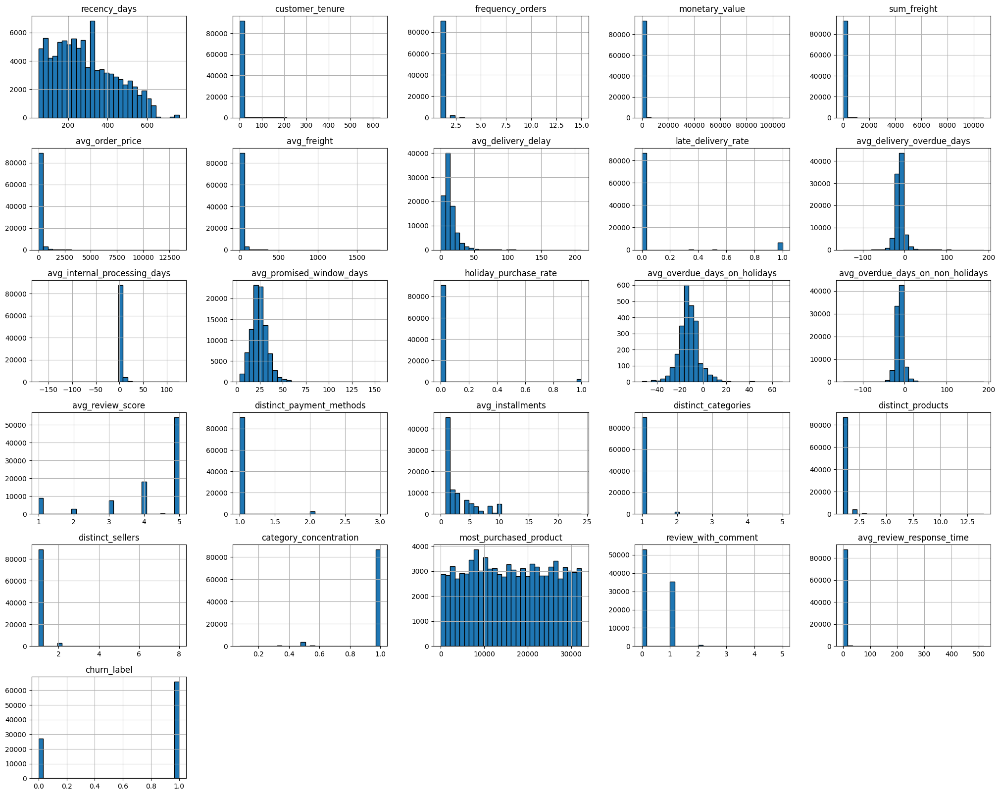

In [75]:
df.hist(figsize=(25, 20), bins=30, edgecolor='black');

In [76]:
from ydata_profiling import ProfileReport
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 28/28 [00:01<00:00, 19.63it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

--- Xử lý dữ liệu bị thiếu ---
Cột 'avg_delivery_delay' đã được điền giá trị trung vị: 10.0
Cột 'avg_delivery_overdue_days' đã được điền giá trị trung vị: -12.0
Cột 'avg_internal_processing_days' đã được điền giá trị trung vị: 2.0
Cột 'avg_review_score' đã được điền giá trị trung vị: 5.0
Cột 'distinct_payment_methods' đã được điền giá trị trung vị: 1.0
Cột 'avg_installments' đã được điền giá trị trung vị: 2.0
Cột 'avg_overdue_days_on_non_holidays' đã được điền giá trị trung vị: -12.0
Cột 'distinct_categories' đã được điền giá trị trung vị: 1.0
Cột 'distinct_products' đã được điền giá trị trung vị: 1.0
Cột 'distinct_sellers' đã được điền giá trị trung vị: 1.0
Cột 'category_concentration' đã được điền giá trị trung vị: 1.0

Kiểm tra lại dữ liệu thiếu sau khi xử lý:
customer_id                             0
recency_days                            0
customer_tenure                         0
frequency_orders                        0
monetary_value                          0
sum_freight     

/tmp/ipykernel_2850/51430326.py:29: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(median_val, inplace=True)
/tmp/ipykernel_2850/51430326.py:29: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.

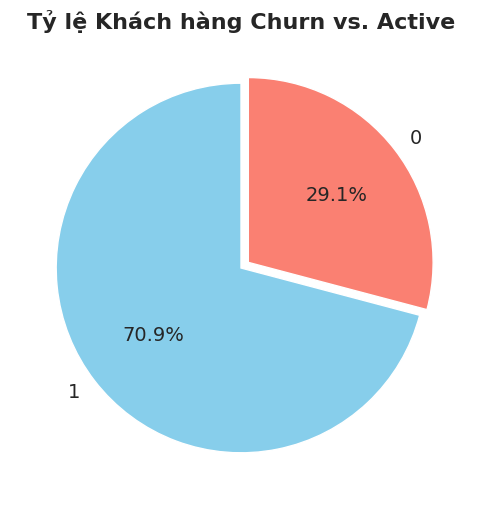


--- Phân tích các Feature chính ---


/tmp/ipykernel_2850/51430326.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


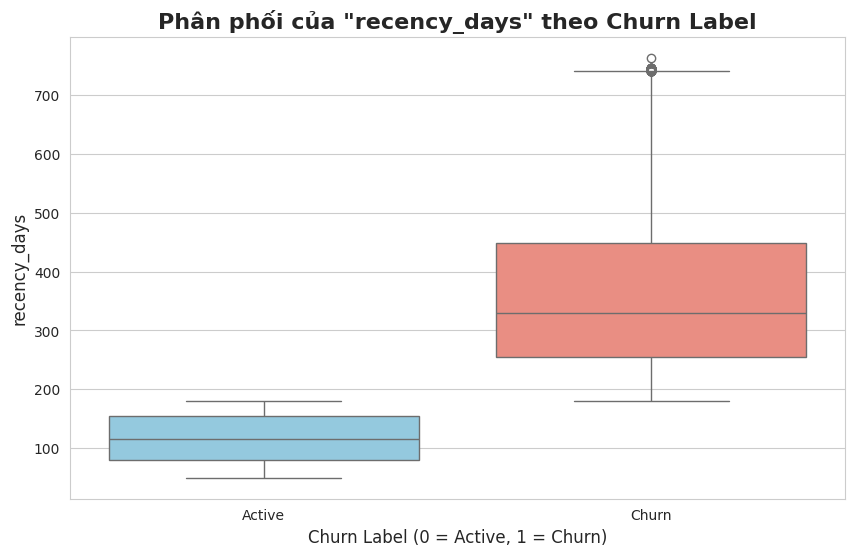

/tmp/ipykernel_2850/51430326.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


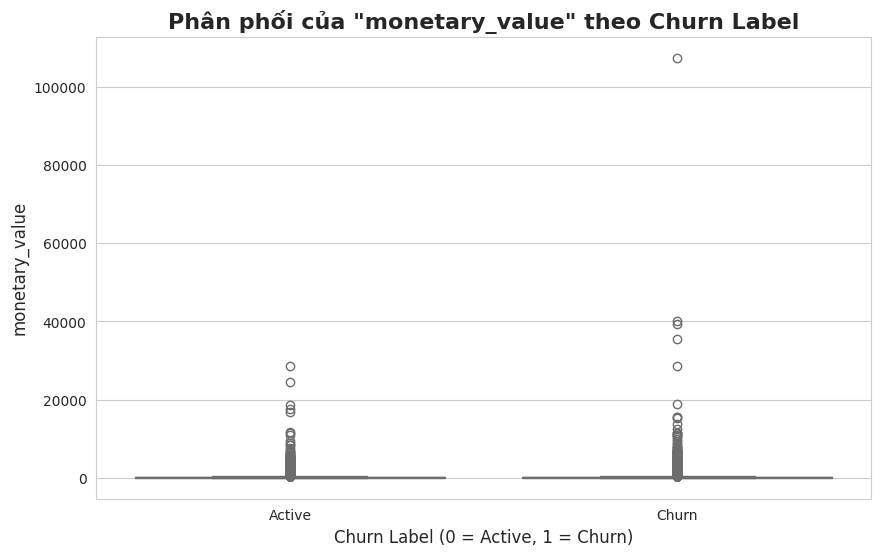

/tmp/ipykernel_2850/51430326.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


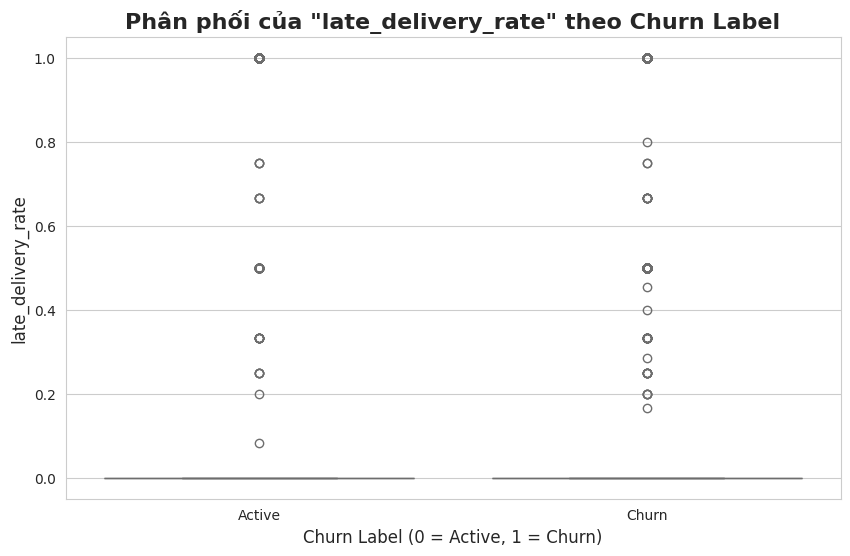

/tmp/ipykernel_2850/51430326.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


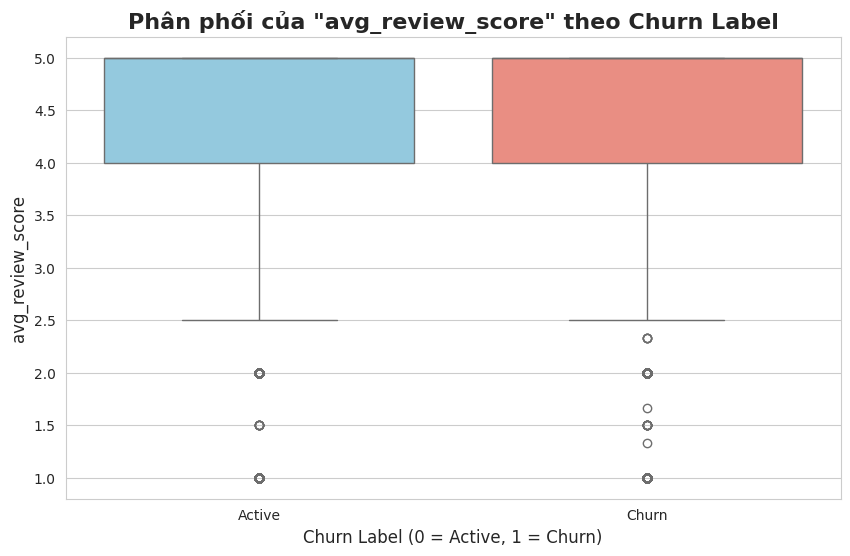

/tmp/ipykernel_2850/51430326.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


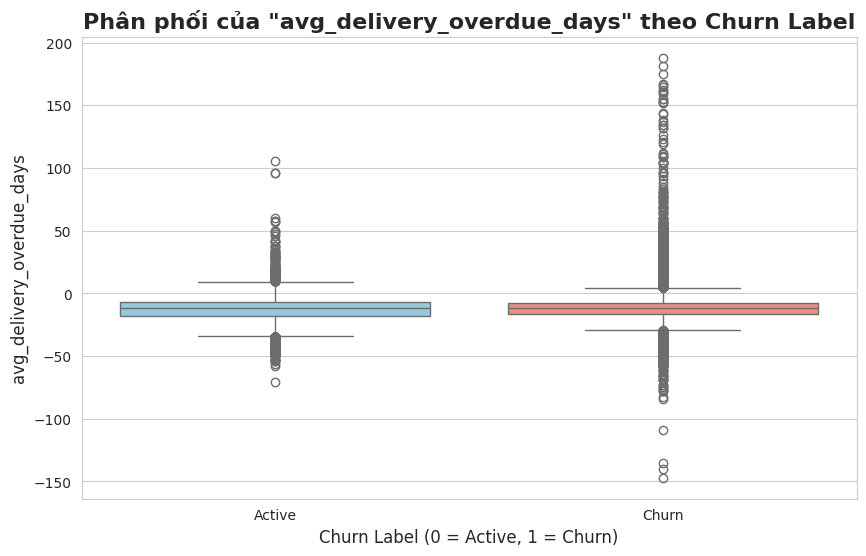

/tmp/ipykernel_2850/51430326.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


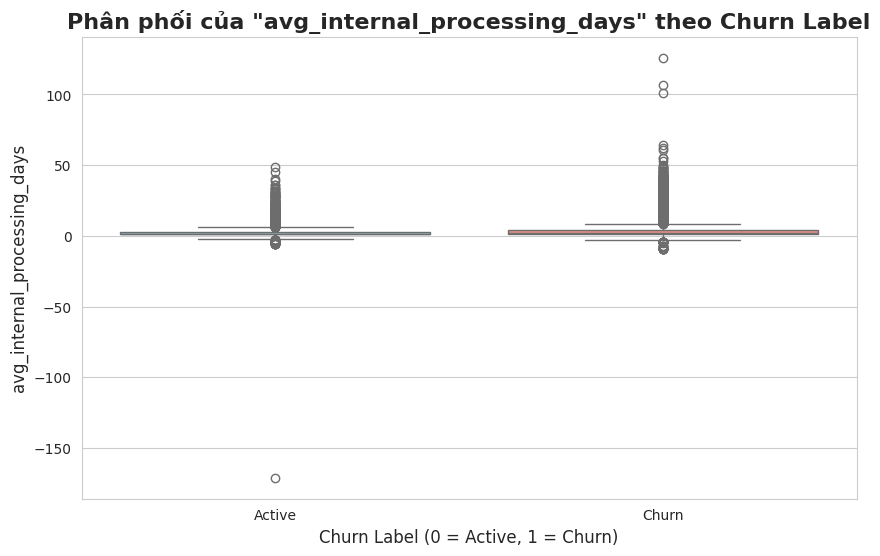

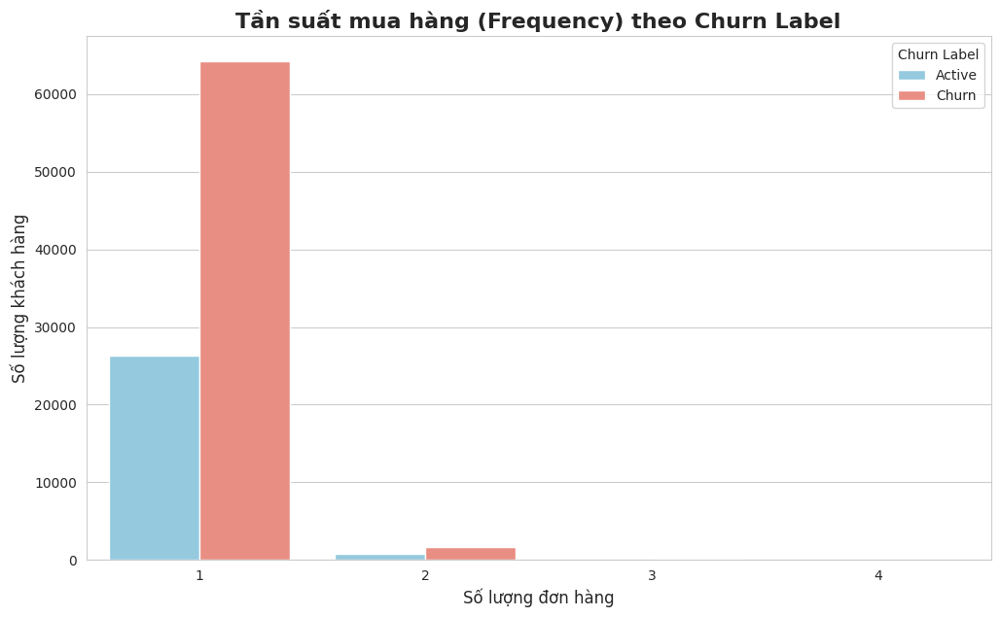

In [77]:
import matplotlib.pyplot as plt
import seaborn as sns



# --- Phần 1: Xử lý dữ liệu bị thiếu (Data Cleaning) ---
print("--- Xử lý dữ liệu bị thiếu ---")

fill_zero_cols = [
    'avg_overdue_days_on_holidays',
    'review_with_comment',
    'avg_review_response_time'
]

# Lấy danh sách các cột còn lại cần điền giá trị
cols_to_fill_median = [
    'avg_delivery_delay', 'avg_delivery_overdue_days', 
    'avg_internal_processing_days', 'avg_review_score', 
    'distinct_payment_methods', 'avg_installments',
    'avg_overdue_days_on_non_holidays',
    'distinct_categories', 'distinct_products', 
    'distinct_sellers', 'category_concentration'
]
fill_categorical_cols = ['most_used_payment_type', 'most_purchased_product']
# Dùng vòng lặp để điền giá trị trung vị (median)
for col in cols_to_fill_median:
    if df[col].isnull().any():
        median_val = df[col].median()
        df[col].fillna(median_val, inplace=True)
        print(f"Cột '{col}' đã được điền giá trị trung vị: {median_val}")

print("\nKiểm tra lại dữ liệu thiếu sau khi xử lý:")
print(df.isnull().sum())
print("-" * 30)
# Điền 0
for col in fill_zero_cols:
    df[col].fillna(0, inplace=True)
# Điền unknown cho categorical
for col in fill_categorical_cols:
    df[col].fillna("unknown", inplace=True)
    
    
    
    
# --- Phần 2: Phân tích biến mục tiêu (Churn Label) ---
print("\n--- Phân tích biến mục tiêu ---")
churn_rate = df['churn_label'].value_counts(normalize=True) * 100
print(f"Tỷ lệ Churn:\n{churn_rate}\n")

# Thiết lập style cho biểu đồ
sns.set_style("whitegrid")

# Vẽ biểu đồ tròn thể hiện tỷ lệ churn
plt.figure(figsize=(8, 6))
df['churn_label'].value_counts().plot.pie(
    autopct='%1.1f%%', 
    colors=['skyblue', 'salmon'],
    startangle=90,
    explode=(0, 0.05),
    textprops={'fontsize': 14}
)
plt.title('Tỷ lệ Khách hàng Churn vs. Active', fontsize=16, fontweight='bold')
plt.ylabel('') # Bỏ nhãn trục y
plt.show()


# --- Phần 3: Phân tích các Feature chính với Churn ---
print("\n--- Phân tích các Feature chính ---")

# Các feature số quan trọng để phân tích
numerical_features = [
    'recency_days', 
    'monetary_value', 
    'late_delivery_rate',
    'avg_review_score',
    'avg_delivery_overdue_days',
    'avg_internal_processing_days'
]

# Dùng vòng lặp để vẽ biểu đồ boxplot cho từng feature
for feature in numerical_features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(
        x='churn_label', 
        y=feature, 
        data=df,
        palette=['skyblue', 'salmon']
    )
    plt.title(f'Phân phối của "{feature}" theo Churn Label', fontsize=16, fontweight='bold')
    plt.xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
    plt.ylabel(feature, fontsize=12)
    plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
    plt.show()

# Phân tích Frequency (vì đây là biến rời rạc)
plt.figure(figsize=(12, 7))
sns.countplot(
    x='frequency_orders',
    hue='churn_label',
    data=df[df['frequency_orders'] < 5], # Chỉ hiển thị cho khách hàng có ít hơn 5 đơn
    palette=['skyblue', 'salmon']
)
plt.title('Tần suất mua hàng (Frequency) theo Churn Label', fontsize=16, fontweight='bold')
plt.xlabel('Số lượng đơn hàng', fontsize=12)
plt.ylabel('Số lượng khách hàng', fontsize=12)
plt.legend(title='Churn Label', labels=['Active', 'Churn'])
plt.show()

--- Xử lý dữ liệu bị thiếu ---

Kiểm tra lại dữ liệu thiếu sau khi xử lý:
customer_id                         0
recency_days                        0
customer_tenure                     0
frequency_orders                    0
monetary_value                      0
sum_freight                         0
avg_order_price                     0
avg_freight                         0
avg_delivery_delay                  0
late_delivery_rate                  0
avg_delivery_overdue_days           0
avg_internal_processing_days        0
avg_promised_window_days            0
holiday_purchase_rate               0
avg_overdue_days_on_holidays        0
avg_overdue_days_on_non_holidays    0
avg_review_score                    0
distinct_payment_methods            0
avg_installments                    0
distinct_categories                 0
distinct_products                   0
distinct_sellers                    0
category_concentration              0
most_purchased_product              0
most_used_paym

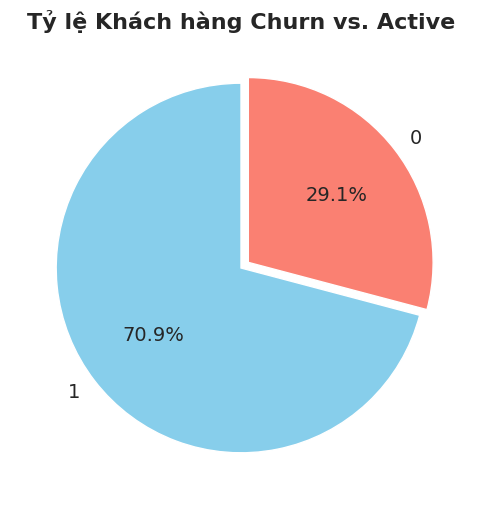


--- Phân tích các Feature chính ---


/tmp/ipykernel_2850/2354685946.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


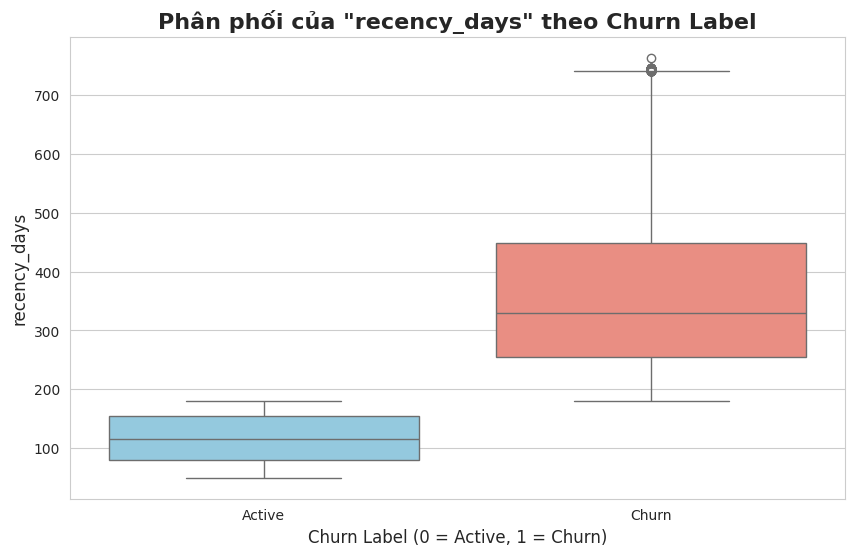

/tmp/ipykernel_2850/2354685946.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


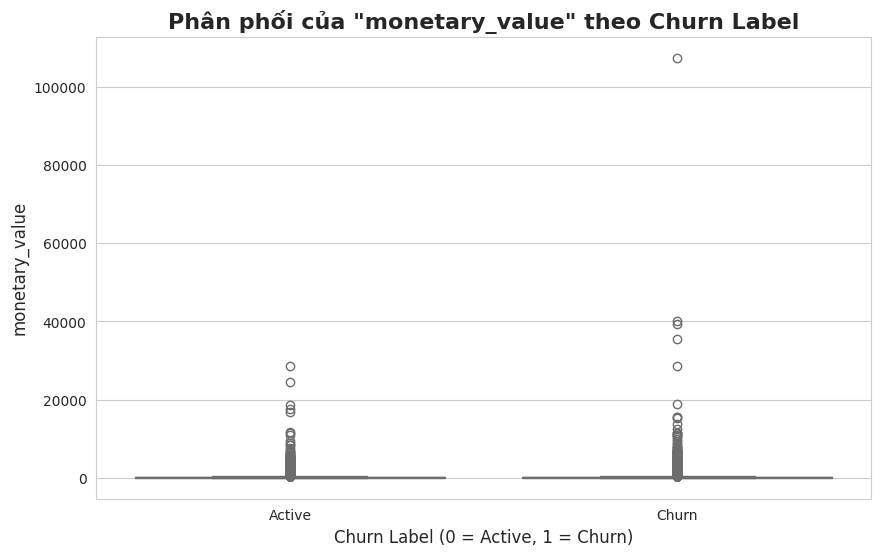

/tmp/ipykernel_2850/2354685946.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


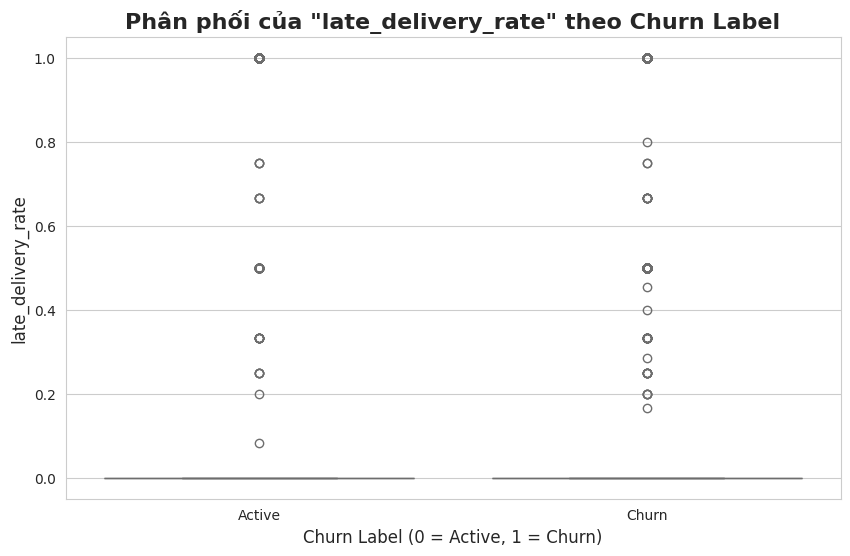

/tmp/ipykernel_2850/2354685946.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


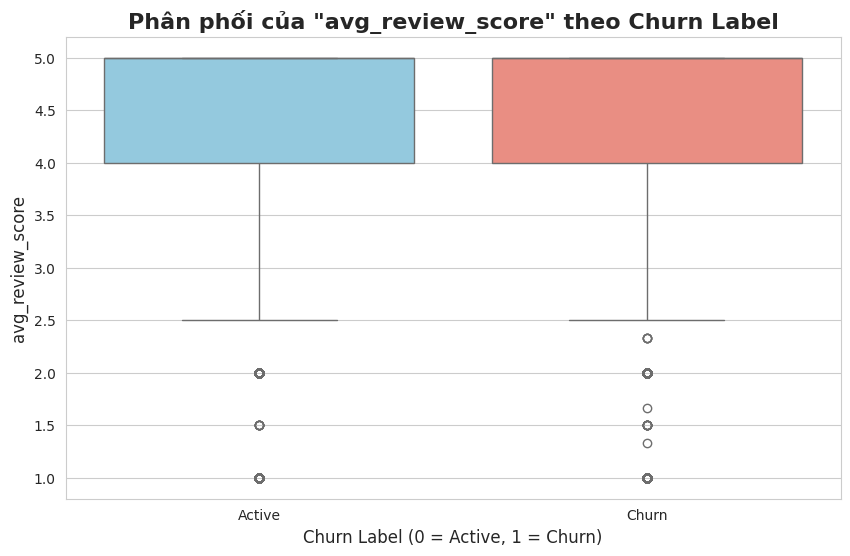

/tmp/ipykernel_2850/2354685946.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


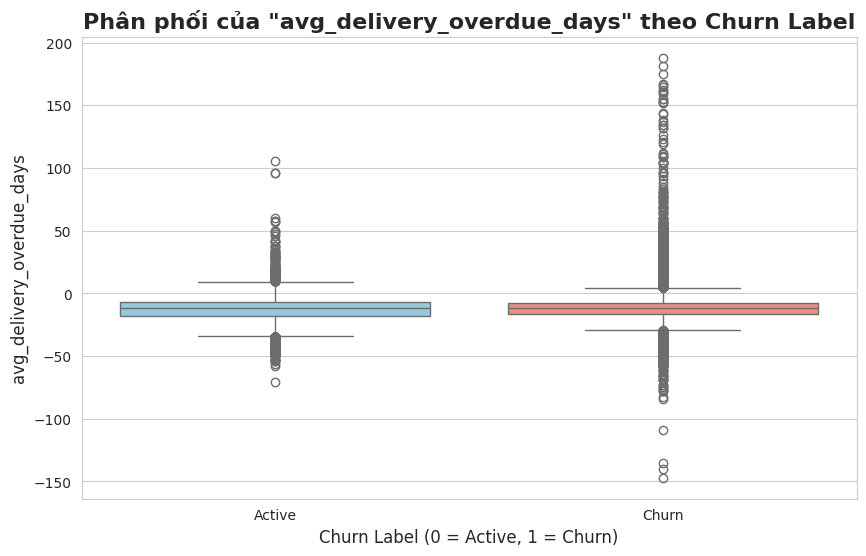

/tmp/ipykernel_2850/2354685946.py:83: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


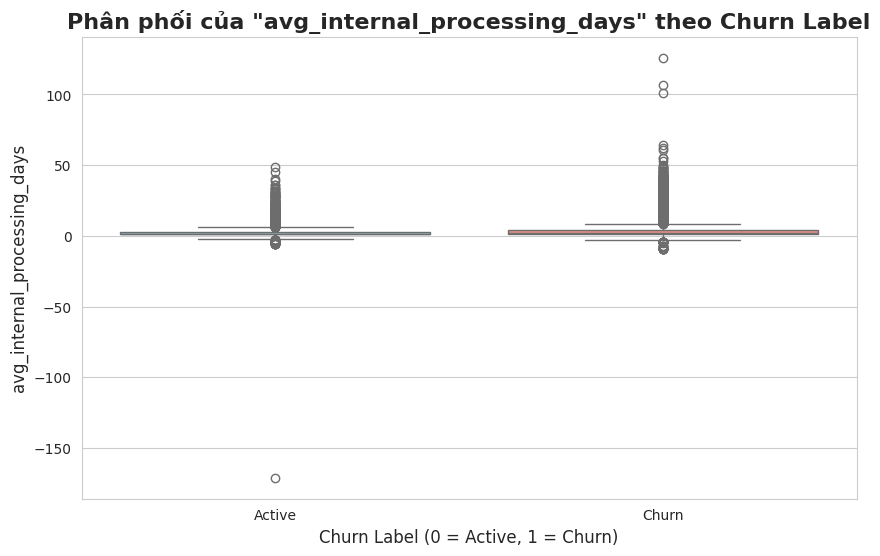

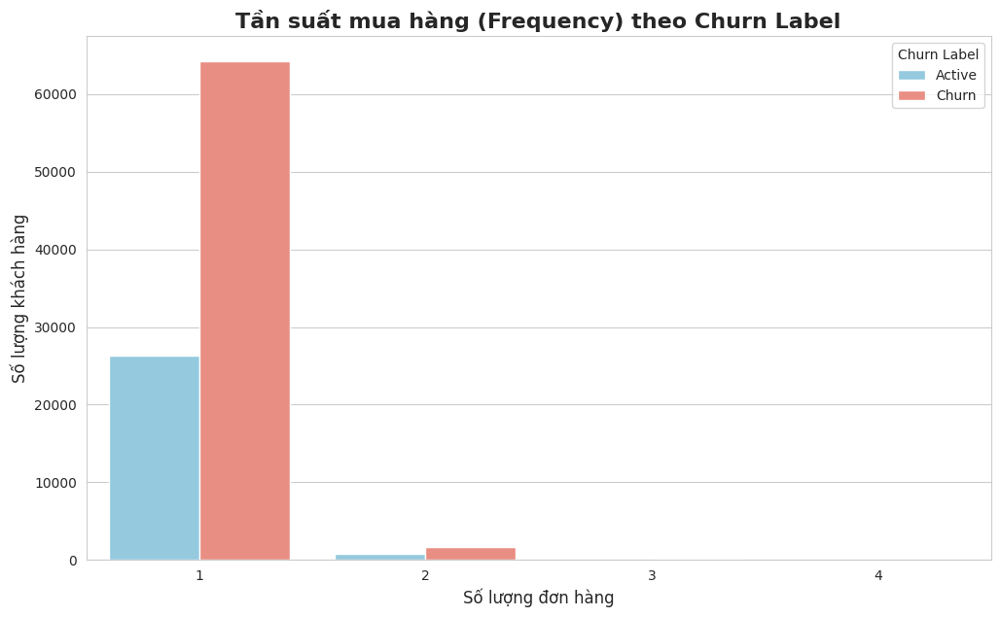

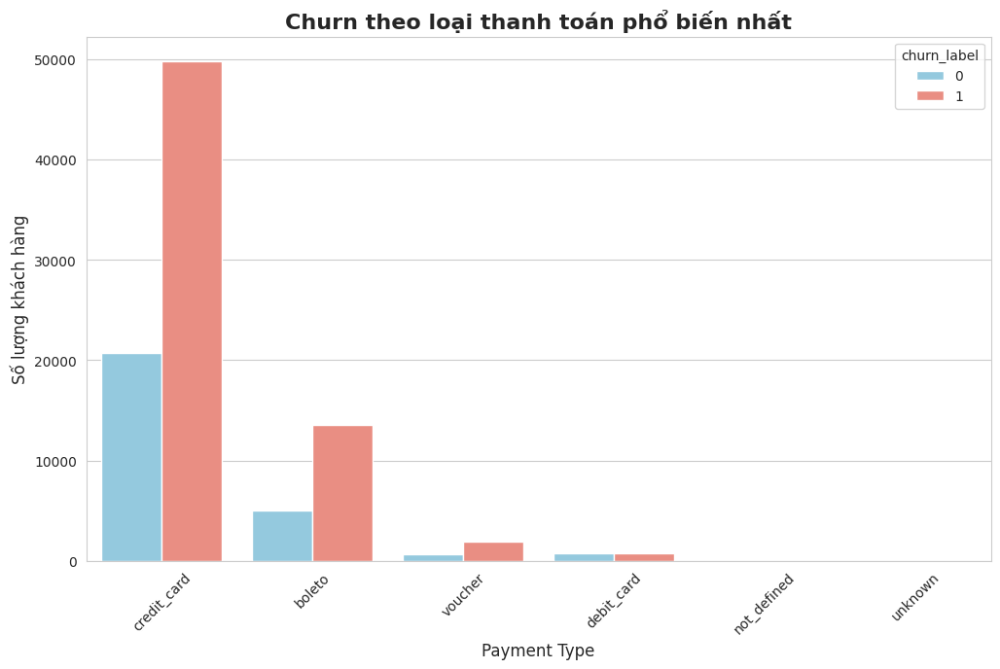

/tmp/ipykernel_2850/2354685946.py:128: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


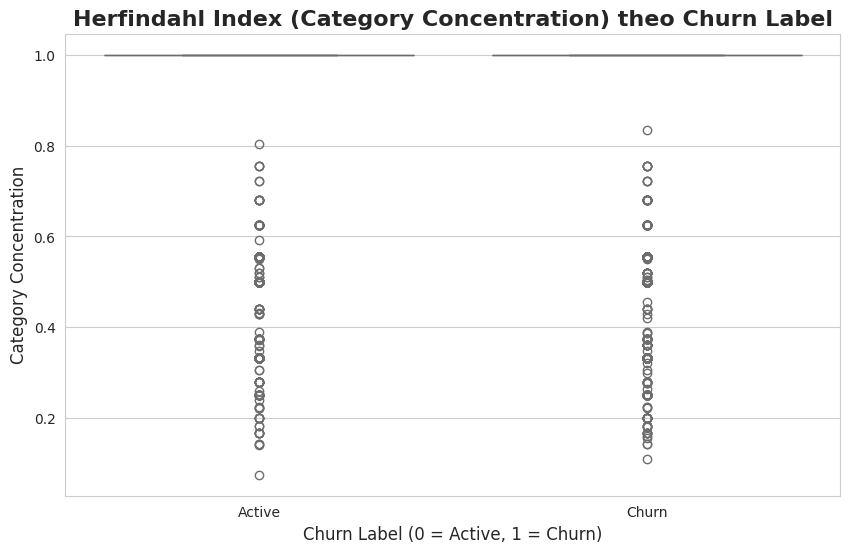

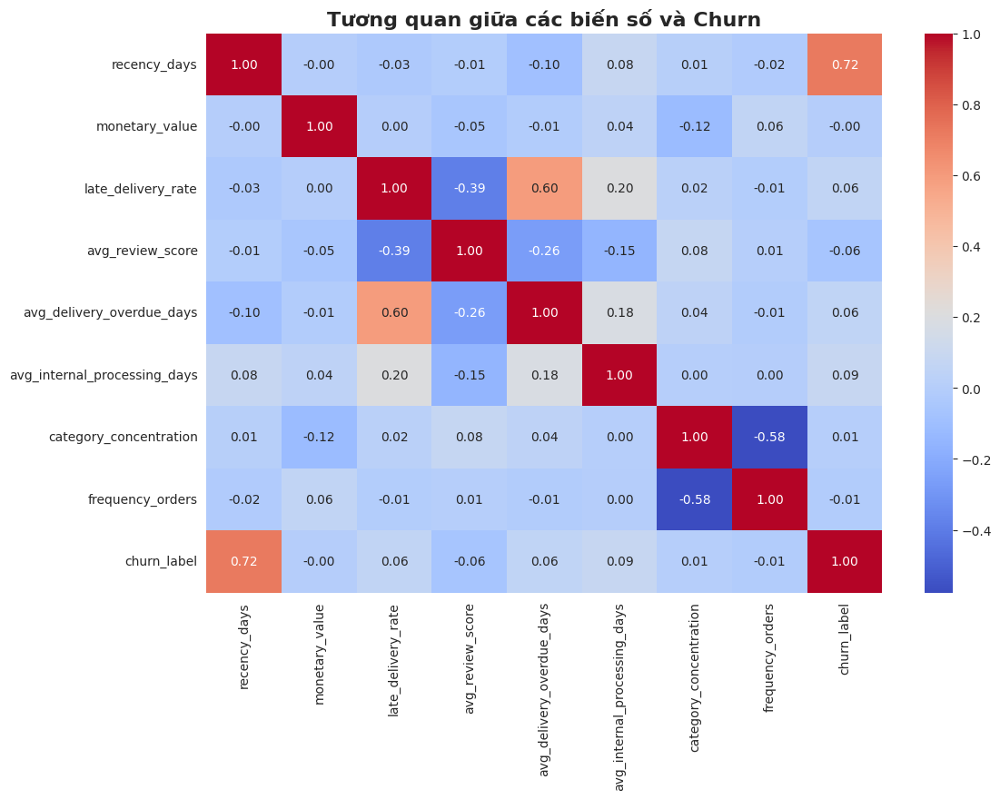

In [78]:
import matplotlib.pyplot as plt
import seaborn as sns

# --- Phần 1: Xử lý dữ liệu bị thiếu (Data Cleaning) ---
print("--- Xử lý dữ liệu bị thiếu ---")

fill_zero_cols = [
    'avg_overdue_days_on_holidays',
    'review_with_comment',
    'avg_review_response_time'
]

cols_to_fill_median = [
    'avg_delivery_delay', 'avg_delivery_overdue_days', 
    'avg_internal_processing_days', 'avg_review_score', 
    'distinct_payment_methods', 'avg_installments',
    'avg_overdue_days_on_non_holidays',
    'distinct_categories', 'distinct_products', 
    'distinct_sellers', 'category_concentration'
]

fill_categorical_cols = ['most_used_payment_type', 'most_purchased_product']

# Điền 0
for col in fill_zero_cols:
    if df[col].isnull().any():
        df[col].fillna(0, inplace=True)
        print(f"Cột '{col}' đã được điền giá trị 0")

# Điền median
for col in cols_to_fill_median:
    if df[col].isnull().any():
        median_val = df[col].median()
        df[col].fillna(median_val, inplace=True)
        print(f"Cột '{col}' đã được điền giá trị trung vị: {median_val}")

# Điền unknown cho categorical
for col in fill_categorical_cols:
    if df[col].isnull().any():
        df[col].fillna("unknown", inplace=True)
        print(f"Cột '{col}' đã được điền giá trị 'unknown'")

print("\nKiểm tra lại dữ liệu thiếu sau khi xử lý:")
print(df.isnull().sum())
print("-" * 30)


# --- Phần 2: Phân tích biến mục tiêu (Churn Label) ---
print("\n--- Phân tích biến mục tiêu ---")
churn_rate = df['churn_label'].value_counts(normalize=True) * 100
print(f"Tỷ lệ Churn:\n{churn_rate}\n")

sns.set_style("whitegrid")

# Pie chart
plt.figure(figsize=(8, 6))
df['churn_label'].value_counts().plot.pie(
    autopct='%1.1f%%', 
    colors=['skyblue', 'salmon'],
    startangle=90,
    explode=(0, 0.05),
    textprops={'fontsize': 14}
)
plt.title('Tỷ lệ Khách hàng Churn vs. Active', fontsize=16, fontweight='bold')
plt.ylabel('')
plt.show()


# --- Phần 3: Phân tích các Feature chính với Churn ---
print("\n--- Phân tích các Feature chính ---")

numerical_features = [
    'recency_days', 
    'monetary_value', 
    'late_delivery_rate',
    'avg_review_score',
    'avg_delivery_overdue_days',
    'avg_internal_processing_days'
]

for feature in numerical_features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(
        x='churn_label', 
        y=feature, 
        data=df,
        palette=['skyblue', 'salmon']
    )
    plt.title(f'Phân phối của "{feature}" theo Churn Label', fontsize=16, fontweight='bold')
    plt.xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
    plt.ylabel(feature, fontsize=12)
    plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
    plt.show()

# Frequency
plt.figure(figsize=(12, 7))
sns.countplot(
    x='frequency_orders',
    hue='churn_label',
    data=df[df['frequency_orders'] < 5],
    palette=['skyblue', 'salmon']
)
plt.title('Tần suất mua hàng (Frequency) theo Churn Label', fontsize=16, fontweight='bold')
plt.xlabel('Số lượng đơn hàng', fontsize=12)
plt.ylabel('Số lượng khách hàng', fontsize=12)
plt.legend(title='Churn Label', labels=['Active', 'Churn'])
plt.show()


# --- Phần 4: Phân tích thêm ---
# 1. Phân phối churn theo loại thanh toán
plt.figure(figsize=(12, 7))
sns.countplot(
    x='most_used_payment_type',
    hue='churn_label',
    data=df,
    palette=['skyblue', 'salmon'],
    order=df['most_used_payment_type'].value_counts().index
)
plt.title('Churn theo loại thanh toán phổ biến nhất', fontsize=16, fontweight='bold')
plt.xlabel('Payment Type', fontsize=12)
plt.ylabel('Số lượng khách hàng', fontsize=12)
plt.xticks(rotation=45)
plt.show()

# 2. Boxplot cho Herfindahl Index (category_concentration)
plt.figure(figsize=(10, 6))
sns.boxplot(
    x='churn_label',
    y='category_concentration',
    data=df,
    palette=['skyblue', 'salmon']
)
plt.title('Herfindahl Index (Category Concentration) theo Churn Label', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
plt.ylabel('Category Concentration', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()

# 3. Heatmap correlation
plt.figure(figsize=(12, 8))
corr = df[numerical_features + ['category_concentration', 'frequency_orders', 'churn_label']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Tương quan giữa các biến số và Churn', fontsize=16, fontweight='bold')
plt.show()


### Some notes:
##### Biểu đồ Tần suất mua hàng "frequency" (Bar Chart):
    Vấn đề churn của doanh nghiệp gần như hoàn toàn là vấn đề không giữ chân được khách hàng sau lần mua đầu tiên. Việc một khách hàng có quay lại mua lần thứ hai hay không là yếu tố quan trọng.
##### Biểu đồ Phân phối của "avg_review_score" (Boxplot)
- Active (Xanh): Hộp rất cao và hẹp, nằm hoàn toàn trong khoảng điểm 4-5. Ít nhất 75% khách hàng active cho điểm từ 4 sao trở lên.

- Churn (Cam): Đường trung vị cũng là 5, nhưng hộp rộng hơn nhiều, kéo dài xuống tận điểm 3. Điều này có nghĩa là trong nhóm churn có một bộ phận đáng kể khách hàng cho điểm thấp.

    Khách hàng trung thành gần như luôn hài lòng (điểm 4-5). Mặc dù không phải ai cho điểm thấp cũng churn, nhưng một điểm đánh giá thấp là một dấu hiệu cảnh báo rất mạnh về nguy cơ khách hàng sẽ rời bỏ.

##### Biểu đồ Phân phối của "avg_delivery_overdue_days" (Boxplot)
    So sánh việc giao hàng sớm hay trễ so với dự kiến. Giá trị âm nghĩa là giao sớm, giá trị dương là giao trễ.

    Trải nghiệm giao hàng vượt kỳ vọng là một yếu tố giữ chân khách hàng cực kỳ hiệu quả. Việc giao hàng sớm có mối liên hệ mạnh mẽ với sự trung thành của khách hàng.

##### monetary_value (Tổng chi tiêu): 
    Hai hộp phân phối gần như y hệt nhau và bị nén ở dưới đáy. Điều này cho thấy tổng chi tiêu không phải là một yếu tố tốt để phân biệt hai nhóm.

##### late_delivery_rate (Tỷ lệ giao hàng trễ):
    Hộp của cả hai nhóm đều là một đường thẳng ở mức 0. Điều này có nghĩa là hơn 75% khách hàng trong cả hai nhóm chưa bao giờ bị giao hàng trễ. Do đó, feature này không có nhiều sức mạnh phân biệt.

##### avg_internal_processing_days (Thời gian xử lý nội bộ):
    Hai hộp phân phối gần như giống hệt nhau. Khách hàng dường như không quan tâm đến thời gian xử lý nội bộ, miễn là ngày nhận hàng cuối cùng đúng như mong đợi.


--- Bắt đầu vẽ các biểu đồ phân tích bổ sung ---


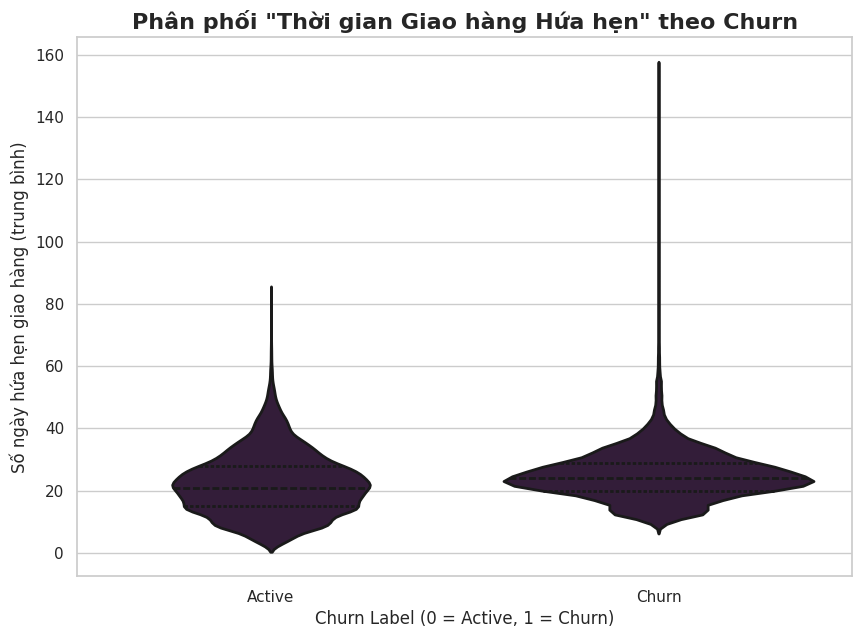

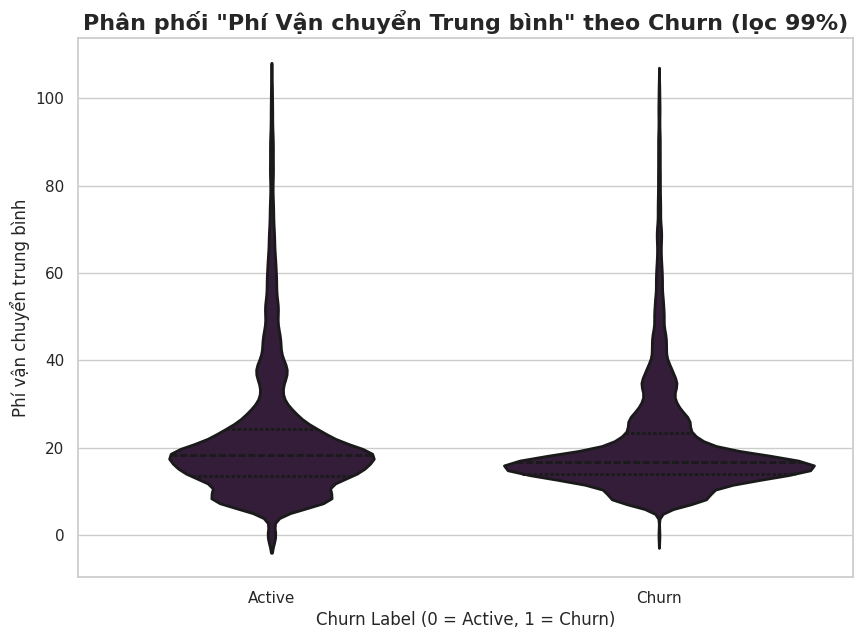

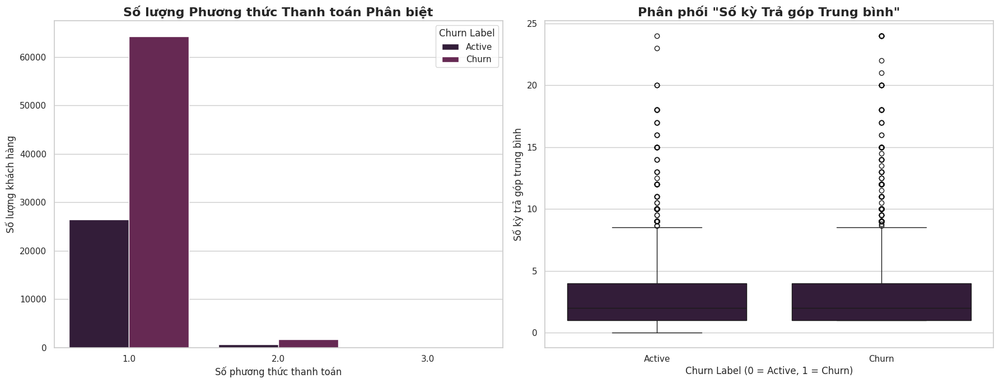

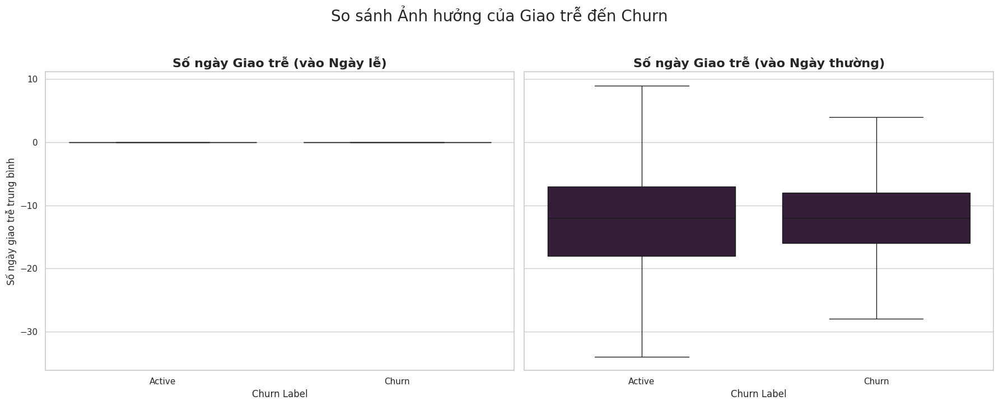

In [79]:

# --- Thiết lập chủ đề và bảng màu cho các biểu đồ ---
sns.set_theme(style="whitegrid", palette="rocket")
print("--- Bắt đầu vẽ các biểu đồ phân tích bổ sung ---")


# --- 1. Phân tích Thời gian Giao hàng Hứa hẹn ---
plt.figure(figsize=(10, 7))
sns.violinplot(
    x='churn_label', 
    y='avg_promised_window_days', 
    data=df,
    inner='quartile', # Hiển thị các đường tứ phân vị bên trong
    linewidth=2
)
plt.title('Phân phối "Thời gian Giao hàng Hứa hẹn" theo Churn', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
plt.ylabel('Số ngày hứa hẹn giao hàng (trung bình)', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()


# --- 2. Phân tích Phí Vận chuyển ---
# Phí vận chuyển có độ lệch rất cao (skewed), ta sẽ giới hạn trục y để xem rõ hơn
plt.figure(figsize=(10, 7))
# Lọc ra 99% dữ liệu để biểu đồ dễ đọc hơn
df_filtered_freight = df[df['avg_freight'] < df['avg_freight'].quantile(0.99)]
sns.violinplot(
    x='churn_label', 
    y='avg_freight', 
    data=df_filtered_freight,
    inner='quartile',
    linewidth=2
)
plt.title('Phân phối "Phí Vận chuyển Trung bình" theo Churn (lọc 99%)', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
plt.ylabel('Phí vận chuyển trung bình', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()


# --- 3. Phân tích Hành vi Thanh toán ---
fig, axes = plt.subplots(1, 2, figsize=(18, 7)) # Tạo 2 biểu đồ trên cùng một hàng

# Biểu đồ 3a: Số lượng phương thức thanh toán
sns.countplot(
    ax=axes[0],
    x='distinct_payment_methods',
    hue='churn_label',
    data=df,
)
axes[0].set_title('Số lượng Phương thức Thanh toán Phân biệt', fontsize=16, fontweight='bold')
axes[0].set_xlabel('Số phương thức thanh toán', fontsize=12)
axes[0].set_ylabel('Số lượng khách hàng', fontsize=12)
axes[0].legend(title='Churn Label', labels=['Active', 'Churn'])

# Biểu đồ 3b: Số kỳ trả góp trung bình
sns.boxplot(
    ax=axes[1],
    x='churn_label', 
    y='avg_installments', 
    data=df,
)
axes[1].set_title('Phân phối "Số kỳ Trả góp Trung bình"', fontsize=16, fontweight='bold')
axes[1].set_xlabel('Churn Label (0 = Active, 1 = Churn)', fontsize=12)
axes[1].set_ylabel('Số kỳ trả góp trung bình', fontsize=12)
axes[1].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

plt.tight_layout() # Tự động điều chỉnh khoảng cách
plt.show()


# --- 4. Phân tích So sánh Giao trễ (Ngày lễ vs. Ngày thường) ---
fig, axes = plt.subplots(1, 2, figsize=(18, 7), sharey=True) # sharey để dùng chung trục y

# Biểu đồ 4a: Giao trễ vào ngày lễ
sns.boxplot(
    ax=axes[0],
    x='churn_label',
    y='avg_overdue_days_on_holidays',
    data=df,
    showfliers=False # Ẩn các điểm ngoại lai để dễ nhìn hơn
)
axes[0].set_title('Số ngày Giao trễ (vào Ngày lễ)', fontsize=16, fontweight='bold')
axes[0].set_xlabel('Churn Label', fontsize=12)
axes[0].set_ylabel('Số ngày giao trễ trung bình', fontsize=12)
axes[0].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

# Biểu đồ 4b: Giao trễ vào ngày thường
sns.boxplot(
    ax=axes[1],
    x='churn_label',
    y='avg_overdue_days_on_non_holidays',
    data=df,
    showfliers=False # Ẩn các điểm ngoại lai
)
axes[1].set_title('Số ngày Giao trễ (vào Ngày thường)', fontsize=16, fontweight='bold')
axes[1].set_xlabel('Churn Label', fontsize=12)
axes[1].set_ylabel('') # Bỏ nhãn trục y vì dùng chung
axes[1].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

plt.suptitle('So sánh Ảnh hưởng của Giao trễ đến Churn', fontsize=20, y=1.03)
plt.tight_layout()
plt.show()


--- Bắt đầu vẽ các biểu đồ phân tích bổ sung ---


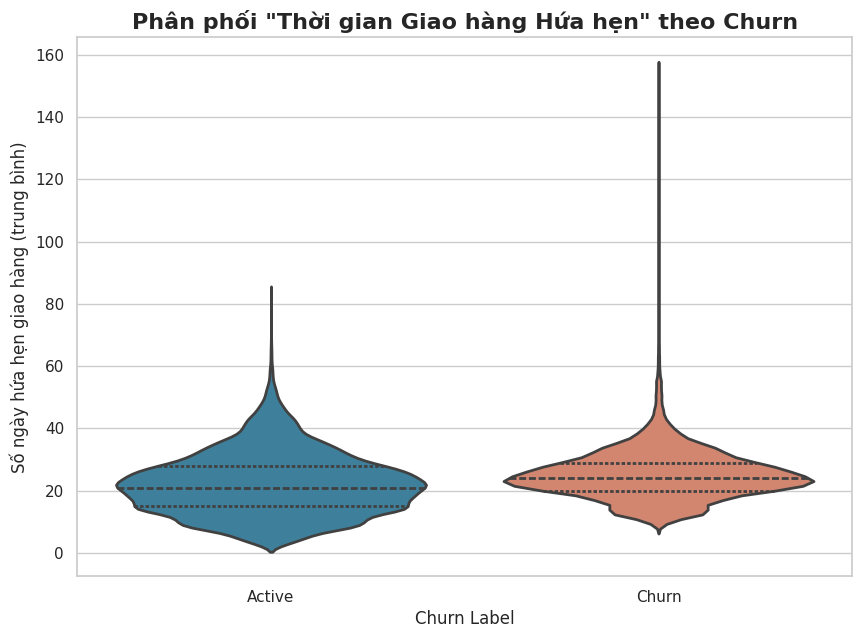

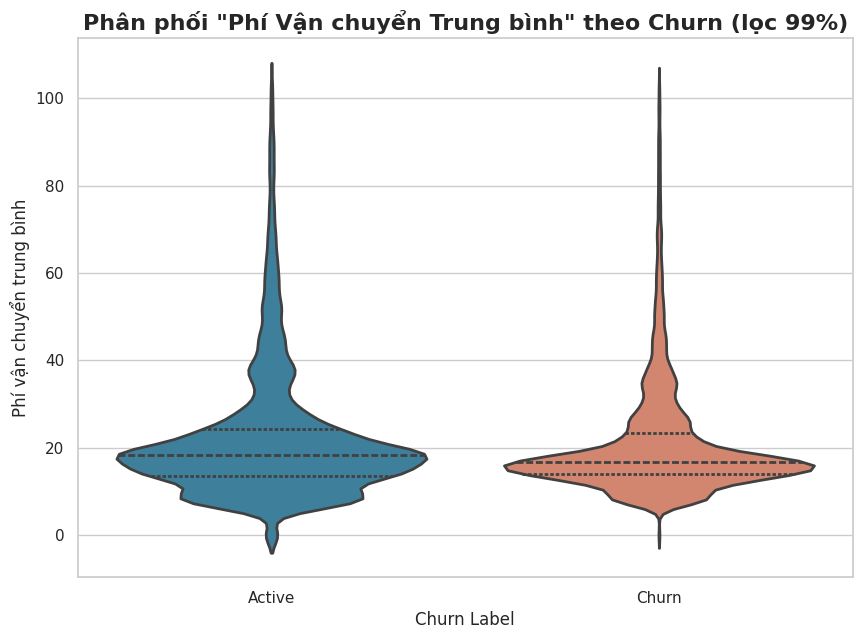

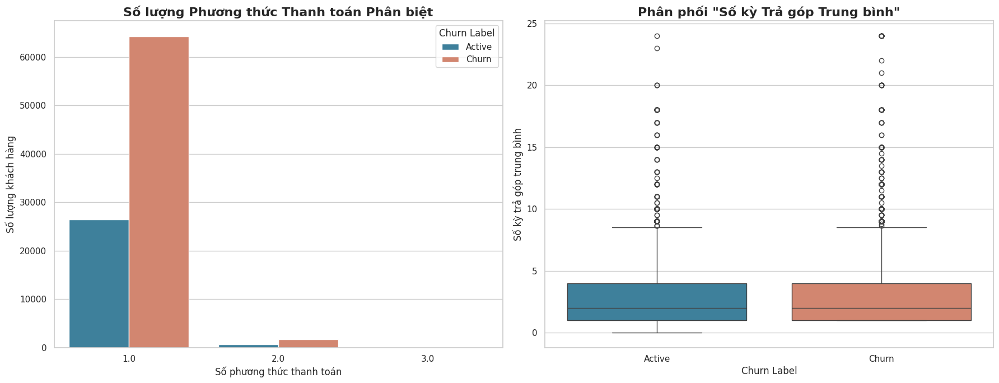

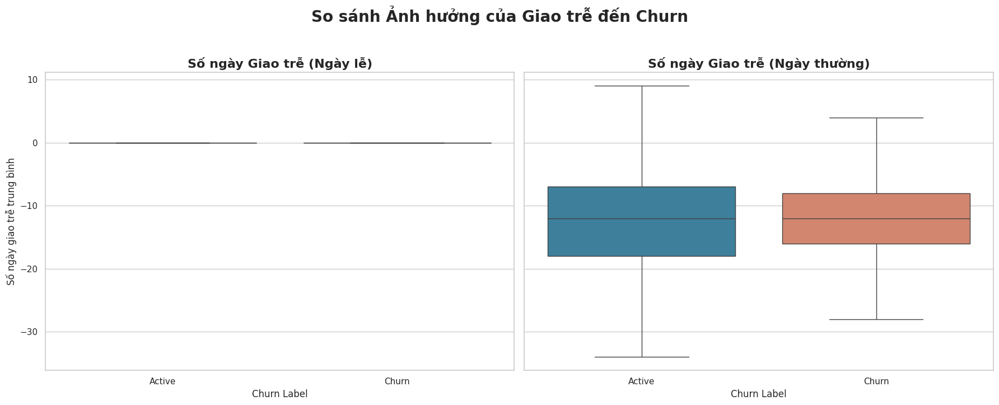

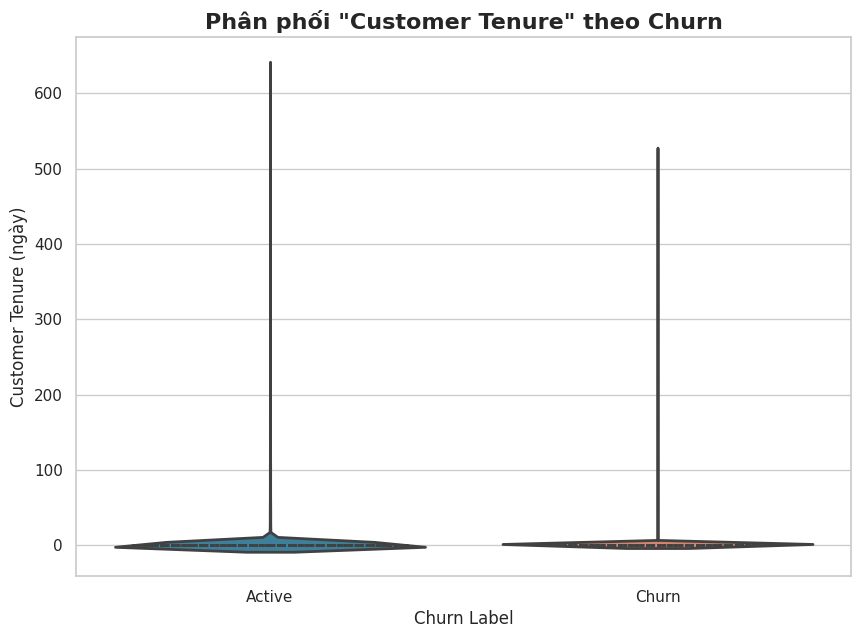

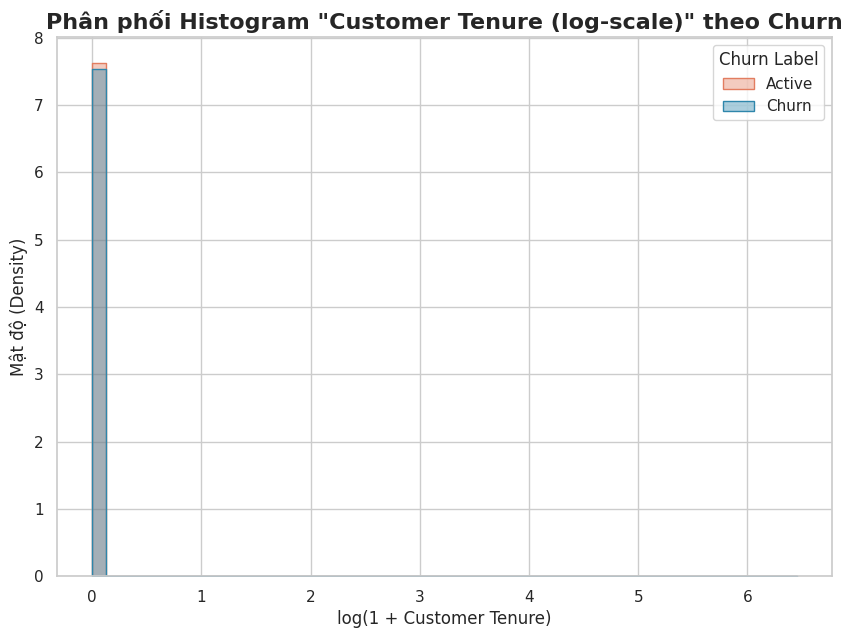

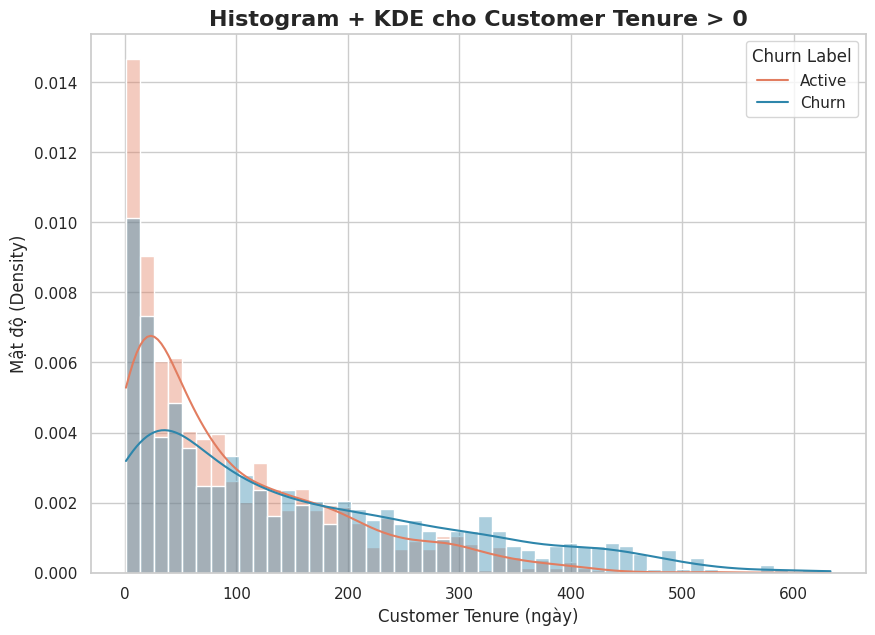

In [80]:
import seaborn as sns
import matplotlib.pyplot as plt

# --- Thiết lập chủ đề và bảng màu ---
sns.set_theme(style="whitegrid")
custom_palette = {0: "#2E86AB", 1: "#E27D60"}  # Xanh cho Active, Cam cho Churn
print("--- Bắt đầu vẽ các biểu đồ phân tích bổ sung ---")


# --- 1. Phân tích Thời gian Giao hàng Hứa hẹn ---
plt.figure(figsize=(10, 7))
sns.violinplot(
    x='churn_label', 
    y='avg_promised_window_days', 
    data=df,
    inner='quartile',
    linewidth=2,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
plt.title('Phân phối "Thời gian Giao hàng Hứa hẹn" theo Churn', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label', fontsize=12)
plt.ylabel('Số ngày hứa hẹn giao hàng (trung bình)', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()


# --- 2. Phân tích Phí Vận chuyển ---
plt.figure(figsize=(10, 7))
df_filtered_freight = df[df['avg_freight'] < df['avg_freight'].quantile(0.99)]
sns.violinplot(
    x='churn_label', 
    y='avg_freight', 
    data=df_filtered_freight,
    inner='quartile',
    linewidth=2,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
plt.title('Phân phối "Phí Vận chuyển Trung bình" theo Churn (lọc 99%)', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label', fontsize=12)
plt.ylabel('Phí vận chuyển trung bình', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()


# --- 3. Phân tích Hành vi Thanh toán ---
fig, axes = plt.subplots(1, 2, figsize=(18, 7))

# Biểu đồ 3a: Số lượng phương thức thanh toán
sns.countplot(
    ax=axes[0],
    x='distinct_payment_methods',
    hue='churn_label',
    data=df,
    palette=custom_palette
)
axes[0].set_title('Số lượng Phương thức Thanh toán Phân biệt', fontsize=16, fontweight='bold')
axes[0].set_xlabel('Số phương thức thanh toán', fontsize=12)
axes[0].set_ylabel('Số lượng khách hàng', fontsize=12)
axes[0].legend(title='Churn Label', labels=['Active', 'Churn'])

# Biểu đồ 3b: Số kỳ trả góp trung bình
sns.boxplot(
    ax=axes[1],
    x='churn_label', 
    y='avg_installments', 
    data=df,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
axes[1].set_title('Phân phối "Số kỳ Trả góp Trung bình"', fontsize=16, fontweight='bold')
axes[1].set_xlabel('Churn Label', fontsize=12)
axes[1].set_ylabel('Số kỳ trả góp trung bình', fontsize=12)
axes[1].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

plt.tight_layout()
plt.show()


# --- 4. Phân tích So sánh Giao trễ (Ngày lễ vs. Ngày thường) ---
fig, axes = plt.subplots(1, 2, figsize=(18, 7), sharey=True)

sns.boxplot(
    ax=axes[0],
    x='churn_label',
    y='avg_overdue_days_on_holidays',
    data=df,
    showfliers=False,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
axes[0].set_title('Số ngày Giao trễ (Ngày lễ)', fontsize=16, fontweight='bold')
axes[0].set_xlabel('Churn Label', fontsize=12)
axes[0].set_ylabel('Số ngày giao trễ trung bình', fontsize=12)
axes[0].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

sns.boxplot(
    ax=axes[1],
    x='churn_label',
    y='avg_overdue_days_on_non_holidays',
    data=df,
    showfliers=False,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
axes[1].set_title('Số ngày Giao trễ (Ngày thường)', fontsize=16, fontweight='bold')
axes[1].set_xlabel('Churn Label', fontsize=12)
axes[1].set_ylabel('')
axes[1].set_xticks(ticks=[0, 1], labels=['Active', 'Churn'])

plt.suptitle('So sánh Ảnh hưởng của Giao trễ đến Churn', fontsize=20, fontweight='bold', y=1.03)
plt.tight_layout()
plt.show()


# --- 5. Phân tích Customer Tenure ---
plt.figure(figsize=(10, 7))
sns.violinplot(
    x='churn_label', 
    y='customer_tenure', 
    data=df,
    inner='quartile',
    linewidth=2,
    hue='churn_label',
    palette=custom_palette,
    legend=False
)
plt.title('Phân phối "Customer Tenure" theo Churn', fontsize=16, fontweight='bold')
plt.xlabel('Churn Label', fontsize=12)
plt.ylabel('Customer Tenure (ngày)', fontsize=12)
plt.xticks(ticks=[0, 1], labels=['Active', 'Churn'])
plt.show()

import numpy as np

# Tạo thêm cột log tenure
df['log_customer_tenure'] = np.log1p(df['customer_tenure'])

plt.figure(figsize=(10, 7))
sns.histplot(
    data=df, 
    x="log_customer_tenure", 
    hue="churn_label", 
    element="step", 
    stat="density", 
    common_norm=False,
    palette=custom_palette,
    bins=50,
    alpha=0.4
)
plt.title('Phân phối Histogram "Customer Tenure (log-scale)" theo Churn', fontsize=16, fontweight='bold')
plt.xlabel('log(1 + Customer Tenure)', fontsize=12)
plt.ylabel('Mật độ (Density)', fontsize=12)
plt.legend(title='Churn Label', labels=['Active', 'Churn'])
plt.show()




# --- Histogram + KDE nhóm tenure > 0 ---
plt.figure(figsize=(10, 7))
sns.histplot(
    data=df[df['customer_tenure'] > 0], 
    x="customer_tenure", 
    hue="churn_label", 
    stat="density", 
    common_norm=False,
    bins=50,
    palette=custom_palette,
    alpha=0.4,
    kde=True
)
plt.title('Histogram + KDE cho Customer Tenure > 0', fontsize=16, fontweight='bold')
plt.xlabel('Customer Tenure (ngày)', fontsize=12)
plt.ylabel('Mật độ (Density)', fontsize=12)
plt.legend(title='Churn Label', labels=['Active', 'Churn'])
plt.show()

### Some notes:

##### Biểu đồ Phân phối "Thời gian Giao hàng Hứa hẹn" (Violin Plot)

    Phân phối của hai nhóm `Active` và `Churn` gần như giống hệt nhau. Điều này cho thấy việc một đơn hàng được hứa hẹn giao trong bao lâu (dài hay ngắn) không phải là yếu tố ảnh hưởng đến việc khách hàng có rời bỏ hay không. Khách hàng quan tâm đến việc có giữ đúng lời hứa giao hàng hay không hơn là bản thân lời hứa đó.

##### Biểu đồ Phân phối "Phí Vận chuyển Trung bình" (Violin Plot)

    Phân phối phí vận chuyển của hai nhóm rất tương đồng, ngay cả sau khi đã lọc các giá trị ngoại lai. Chi phí vận chuyển không phải là một yếu tố dự báo churn mạnh.

##### Biểu đồ Hành vi Thanh toán (Payment Behavior)

    Gần như toàn bộ khách hàng chỉ sử dụng 1 phương thức thanh toán và có thói quen trả góp tương tự nhau (trung vị là 1 - trả thẳng). Do đó, hành vi thanh toán không cho thấy sự khác biệt rõ rệt giữa khách hàng trung thành và khách hàng đã rời bỏ.

##### Biểu đồ So sánh Ảnh hưởng của Giao trễ đến Churn (Boxplot)

    Biểu đồ cho thấy sự chậm trễ trong ngày lễ không ảnh hưởng đến churn. Tuy nhiên, vào ngày thường, nhóm `Active` có xu hướng nhận hàng sớm hơn nhóm `Churn`. Điều này khẳng định rằng trải nghiệm giao hàng vào một ngày làm việc bình thường mới thực sự quan trọng và có ảnh hưởng đến lòng trung thành của khách hàng.


##### Biểu đồ Phân phối customer tenure theo churn
    Màu xanh (Active) và màu cam (Churn) gần như chồng lên nhau ở cột đầu tiên → cả khách churn và active đều có nhiều người tenure ngắn.
    Tuy nhiên, ở các mức tenure cao hơn (100+ ngày), dường như Active chiếm ưu thế → khách gắn bó lâu năm thì ít khi churn.

# Train machine learning model 

In [13]:
df.head()

,customer_key,recency_days,customer_tenure,frequency_orders,monetary_value,avg_order_price,sum_freight,avg_freight,avg_delivery_delay,late_delivery_rate,...,avg_internal_processing_days,avg_promised_window_days,holiday_purchase_rate,avg_overdue_days_on_holidays,avg_overdue_days_on_non_holidays,avg_review_score,distinct_payment_methods,avg_installments,churn_label,log_customer_tenure
0,54383,78,0,1,22.5,22.5,18.26,18.26,9.0,0.0,...,0.0,23.0,0.0,0.0,-14.0,5.0,1.0,1.0,0,0.0
1,45761,411,0,1,28.9,28.9,13.37,13.37,16.0,0.0,...,2.0,19.0,0.0,0.0,-3.0,5.0,1.0,1.0,1,0.0
2,73174,351,0,1,69.9,69.9,16.25,16.25,13.0,0.0,...,7.0,21.0,0.0,0.0,-8.0,1.0,1.0,2.0,1,0.0
3,28613,279,0,1,69.9,69.9,38.04,38.04,41.0,1.0,...,3.0,27.0,0.0,0.0,14.0,1.0,1.0,4.0,1,0.0
4,50738,471,0,1,89.9,89.9,24.94,24.94,8.0,0.0,...,4.0,21.0,0.0,0.0,-13.0,4.0,1.0,1.0,1,0.0


In [14]:

def prepare_X_y(df):
    """
    Feature engineering and create X and y
    :param df: pandas dataframe
    :return: (X, y) output feature matrix (dataframe), target (series)
    """
    X = df.drop(columns=['customer_key', 'recency_days','log_customer_tenure','churn_label'])
    y = df['churn_label'] # Todo: Select label
    return X, y
X, y = prepare_X_y(df)

from sklearn.model_selection import train_test_split
RANDOM_STATE = 42
TRAIN_SIZE = 0.8

X_train, X_test ,y_train, y_test = train_test_split(X, y, train_size=TRAIN_SIZE, random_state=RANDOM_STATE)
print(f"Training set size: {len(X_train)}")
print(f"Testing set size: {len(X_test)}")

Training set size: 74484
Testing set size: 18622


In [16]:
!nvidia-smi


Sun Sep 21 18:41:50 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 580.82.09              Driver Version: 580.82.09      CUDA Version: 13.0     |
+-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4050 ...    Off |   00000000:01:00.0 Off |                  N/A |
| N/A   57C    P3            590W /   60W |       0MiB /   6141MiB |      2%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [15]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from joblib import dump, load
from typing import Any, Dict, Optional

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import Pipeline # Sử dụng pipeline của imblearn để tích hợp sampler

class ModelTuner:
    """
    Một lớp để tự động hóa việc tìm kiếm siêu tham số, huấn luyện và đánh giá mô hình.

    Bao gồm các bước:
    1. Xây dựng pipeline với tùy chọn sampler (để xử lý mất cân bằng) và scaler.
    2. Tìm kiếm siêu tham số tốt nhất bằng GridSearchCV.
    3. Đánh giá mô hình trên các tập dữ liệu khác nhau.
    4. Cung cấp các công cụ hỗ trợ như vẽ confusion matrix, lưu/tải mô hình.
    """
    def __init__(self, model: Any, param_grid: Dict, sampler: Optional[Any] = None, scoring: str = 'f1_weighted', cv: int = 5, n_jobs: int = -1):
        """
        Khởi tạo ModelTuner.

        Args:
            model (Any): Một estimator của scikit-learn (ví dụ: LogisticRegression()).
            param_grid (Dict): Dictionary chứa các siêu tham số để tìm kiếm.
            sampler (Optional[Any], optional): Một sampler từ imblearn (ví dụ: SMOTE()). Mặc định là None.
            scoring (str, optional): Metric để tối ưu hóa. Mặc định là 'f1'.
            cv (int, optional): Số fold cho cross-validation. Mặc định là 5.
            n_jobs (int, optional): Số job chạy song song. -1 là dùng tất cả core. Mặc định là -1.
        """
        self.model = model
        self.param_grid = param_grid
        self.sampler = sampler
        self.scoring = scoring
        self.cv = cv
        self.n_jobs = n_jobs
        
        self.best_estimator_: Optional[Pipeline] = None
        self.grid_search_: Optional[GridSearchCV] = None
        self.train_results_: Optional[Dict] = None
        self.test_results_: Optional[Dict] = None

    def fit(self, X_train: pd.DataFrame, y_train: pd.Series):
        """
        Huấn luyện mô hình sử dụng GridSearchCV.
        """
        steps = []
        if self.sampler:
            steps.append(('sampler', self.sampler))
        steps.append(('scaler', StandardScaler()))
        steps.append(('clf', self.model))
        
        pipe = Pipeline(steps)

        # Thêm tiền tố 'clf__' vào các key trong param_grid
        grid_params = {'clf__' + k: v for k, v in self.param_grid.items()}

        grid = GridSearchCV(
            estimator=pipe,
            param_grid=grid_params,
            scoring=self.scoring,
            cv=self.cv,
            n_jobs=self.n_jobs,
            verbose=1
        )
        grid.fit(X_train, y_train)

        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_

        print("\n=== Best Parameters Found ===")
        best_params_cleaned = {k.replace('clf__', ''): v for k, v in grid.best_params_.items()}
        print(best_params_cleaned)
        print(f"\nBest cross-validation {self.scoring} score: {grid.best_score_:.4f}")
        return self # <-- self, cho phép chaining

    def evaluate(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Đánh giá mô hình trên một tập dữ liệu cụ thể.

        Args:
            X (pd.DataFrame): Dữ liệu features.
            y (pd.Series): Dữ liệu target.
            dataset_name (str, optional): Tên của tập dữ liệu (ví dụ: 'Train', 'Test').

        Returns:
            Dict: Một dictionary chứa các metric đánh giá.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please call .fit() first.")

        y_pred = self.best_estimator_.predict(X)

        print(f"\n=== Evaluation on {dataset_name} Set ===")
        print(classification_report(y, y_pred, digits=4))

        results = {
            "accuracy": accuracy_score(y, y_pred),
            "precision": precision_score(y, y_pred, average='weighted'),
            "recall": recall_score(y, y_pred, average='weighted'),
            "f1": f1_score(y, y_pred, average='weighted')
        }
        return results

    def evaluate_train_test(self, X_train: pd.DataFrame, y_train: pd.Series, X_test: pd.DataFrame, y_test: pd.Series):
        """
        Một hàm tiện ích để đánh giá trên cả tập train và test.
        """
        self.train_results_ = self.evaluate(X_train, y_train, dataset_name='Train')
        self.test_results_ = self.evaluate(X_test, y_test, dataset_name='Test')
        
        print("\n--- Summary ---")
        print(f"Train F1-Score: {self.train_results_['f1']:.4f}")
        print(f"Test F1-Score:  {self.test_results_['f1']:.4f}")

    def plot_confusion_matrix(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Vẽ confusion matrix cho một tập dữ liệu.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please call .fit() first.")
        
        y_pred = self.best_estimator_.predict(X)
        cm = confusion_matrix(y, y_pred)
        
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix for {dataset_name} Set')
        plt.show()

    def get_cv_results_df(self) -> Optional[pd.DataFrame]:
        """
        Lấy kết quả cross-validation từ GridSearchCV và chuyển thành DataFrame.
        """
        if self.grid_search_ is None:
            print("GridSearchCV has not been run. Please call .fit() first.")
            return None
        return pd.DataFrame(self.grid_search_.cv_results_)

    def save_model(self, filepath: str):
        """
        Lưu mô hình tốt nhất (toàn bộ pipeline) vào một file.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("No best estimator to save. Please call .fit() first.")
        dump(self.best_estimator_, filepath)
        print(f"Model saved to {filepath}")

    @staticmethod   
    def load_model(filepath: str) -> Pipeline:
        """
        Tải một mô hình từ file.
        """
        model = load(filepath)
        print(f"Model loaded from {filepath}")
        return model

In [18]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression(solver='liblinear', random_state=42)
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': [0.01, 0.1, 1, 10,50,70, 100],
    'class_weight': [None, 'balanced']
}
tuner = ModelTuner(
    model=model,
    param_grid=param_grid,
    n_jobs=10
)
# Huấn luyện mô hình
tuner.fit(X_train, y_train)
# Đánh giá trên cả hai tập dữ liệu
tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
# Vẽ confusion matrix cho tập test
tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

# 6. Xem kết quả chi tiết của cross-validation
cv_results = tuner.get_cv_results_df()
if cv_results is not None:
    # In ra 5 dòng đầu của các cột quan trọng
    print("\n\n=== CV Results Summary ===")
    print(cv_results[['param_clf__C', 'param_clf__penalty', 'mean_test_score', 'std_test_score']].head())

Fitting 5 folds for each of 28 candidates, totalling 140 fits


KeyboardInterrupt: 

In [ ]:
# from sklearn.linear_model import LogisticRegression
# from imblearn.over_sampling import SMOTE
# model = LogisticRegression(solver='liblinear', random_state=42)
# param_grid = {
#     'penalty': ['l1', 'l2'],
#     'C': [0.01, 0.1, 1, 10, 100],
#     'class_weight': [None, 'balanced']
# }
# tuner = ModelTuner(
#     model=model,
#     param_grid=param_grid,
#     n_jobs=10,
#     sampler=SMOTE(random_state=42)
# )
# # Huấn luyện mô hình
# tuner.fit(X_train, y_train)
# # Đánh giá trên cả hai tập dữ liệu
# tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
# # Vẽ confusion matrix cho tập test
# tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

# # 6. Xem kết quả chi tiết của cross-validation
# cv_results = tuner.get_cv_results_df()
# if cv_results is not None:
#     # In ra 5 dòng đầu của các cột quan trọng
#     print("\n\n=== CV Results Summary ===")
#     print(cv_results[['param_clf__C', 'param_clf__penalty', 'mean_test_score', 'std_test_score']].head())

In [23]:
import cuml

In [ ]:
%load_ext cuml.accel

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from joblib import dump, load
from typing import Any, Dict, Optional

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import Pipeline # Sử dụng pipeline của imblearn để tích hợp sampler

class ModelTuner:
    """
    Một lớp để tự động hóa việc tìm kiếm siêu tham số, huấn luyện và đánh giá mô hình.

    Bao gồm các bước:
    1. Xây dựng pipeline với tùy chọn sampler (để xử lý mất cân bằng) và scaler.
    2. Tìm kiếm siêu tham số tốt nhất bằng GridSearchCV.
    3. Đánh giá mô hình trên các tập dữ liệu khác nhau.
    4. Cung cấp các công cụ hỗ trợ như vẽ confusion matrix, lưu/tải mô hình.
    """
    def __init__(self, model: Any, param_grid: Dict, sampler: Optional[Any] = None, scoring: str = 'f1_weighted', cv: int = 5):
        """
        Khởi tạo ModelTuner.

        Args:
            model (Any): Một estimator của scikit-learn (ví dụ: LogisticRegression()).
            param_grid (Dict): Dictionary chứa các siêu tham số để tìm kiếm.
            sampler (Optional[Any], optional): Một sampler từ imblearn (ví dụ: SMOTE()). Mặc định là None.
            scoring (str, optional): Metric để tối ưu hóa. Mặc định là 'f1'.
            cv (int, optional): Số fold cho cross-validation. Mặc định là 5.
            
        """
        self.model = model
        self.param_grid = param_grid
        self.sampler = sampler
        self.scoring = scoring
        self.cv = cv
        
        self.best_estimator_: Optional[Pipeline] = None
        self.grid_search_: Optional[GridSearchCV] = None
        self.train_results_: Optional[Dict] = None
        self.test_results_: Optional[Dict] = None

    def fit(self, X_train: pd.DataFrame, y_train: pd.Series):
        """
        Huấn luyện mô hình sử dụng GridSearchCV.
        """
        steps = []
        if self.sampler:
            steps.append(('sampler', self.sampler))
        steps.append(('scaler', StandardScaler()))
        steps.append(('clf', self.model))
        
        pipe = Pipeline(steps)

        # Thêm tiền tố 'clf__' vào các key trong param_grid
        grid_params = {'clf__' + k: v for k, v in self.param_grid.items()}

        grid = GridSearchCV(
            estimator=pipe,
            param_grid=grid_params,
            scoring=self.scoring,
            cv=self.cv,
            verbose=1
        )
        grid.fit(X_train, y_train)

        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_

        print("\n=== Best Parameters Found ===")
        best_params_cleaned = {k.replace('clf__', ''): v for k, v in grid.best_params_.items()}
        print(best_params_cleaned)
        print(f"\nBest cross-validation {self.scoring} score: {grid.best_score_:.4f}")
        return self # <-- self, cho phép chaining

    def evaluate(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Đánh giá mô hình trên một tập dữ liệu cụ thể.

        Args:
            X (pd.DataFrame): Dữ liệu features.
            y (pd.Series): Dữ liệu target.
            dataset_name (str, optional): Tên của tập dữ liệu (ví dụ: 'Train', 'Test').

        Returns:
            Dict: Một dictionary chứa các metric đánh giá.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please call .fit() first.")

        y_pred = self.best_estimator_.predict(X)

        print(f"\n=== Evaluation on {dataset_name} Set ===")
        print(classification_report(y, y_pred, digits=4))

        results = {
            "accuracy": accuracy_score(y, y_pred),
            "precision": precision_score(y, y_pred, average='weighted'),
            "recall": recall_score(y, y_pred, average='weighted'),
            "f1": f1_score(y, y_pred, average='weighted')
        }
        return results

    def evaluate_train_test(self, X_train: pd.DataFrame, y_train: pd.Series, X_test: pd.DataFrame, y_test: pd.Series):
        """
        Một hàm tiện ích để đánh giá trên cả tập train và test.
        """
        self.train_results_ = self.evaluate(X_train, y_train, dataset_name='Train')
        self.test_results_ = self.evaluate(X_test, y_test, dataset_name='Test')
        
        print("\n--- Summary ---")
        print(f"Train F1-Score: {self.train_results_['f1']:.4f}")
        print(f"Test F1-Score:  {self.test_results_['f1']:.4f}")

    def plot_confusion_matrix(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Vẽ confusion matrix cho một tập dữ liệu.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please call .fit() first.")
        
        y_pred = self.best_estimator_.predict(X)
        cm = confusion_matrix(y, y_pred)
        
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix for {dataset_name} Set')
        plt.show()

    def get_cv_results_df(self) -> Optional[pd.DataFrame]:
        """
        Lấy kết quả cross-validation từ GridSearchCV và chuyển thành DataFrame.
        """
        if self.grid_search_ is None:
            print("GridSearchCV has not been run. Please call .fit() first.")
            return None
        return pd.DataFrame(self.grid_search_.cv_results_)

    def save_model(self, filepath: str):
        """
        Lưu mô hình tốt nhất (toàn bộ pipeline) vào một file.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("No best estimator to save. Please call .fit() first.")
        dump(self.best_estimator_, filepath)
        print(f"Model saved to {filepath}")

    @staticmethod   
    def load_model(filepath: str) -> Pipeline:
        """
        Tải một mô hình từ file.
        """
        model = load(filepath)
        print(f"Model loaded from {filepath}")
        return model
    


   

from sklearn.linear_model import LogisticRegression


model = LogisticRegression(solver='liblinear', random_state=42)
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': [0.01, 0.1, 1, 10,50,70, 100],
    'class_weight': [None, 'balanced']
}
tuner = ModelTuner(
    model=model,
    param_grid=param_grid
)
# Huấn luyện mô hình
tuner.fit(X_train, y_train)
# Đánh giá trên cả hai tập dữ liệu
tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
# Vẽ confusion matrix cho tập test
tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

# 6. Xem kết quả chi tiết của cross-validation
cv_results = tuner.get_cv_results_df()
if cv_results is not None:
    # In ra 5 dòng đầu của các cột quan trọng
    print("\n\n=== CV Results Summary ===")
    print(cv_results[['param_clf__C', 'param_clf__penalty', 'mean_test_score', 'std_test_score']].head())

The cuml.accel extension is already loaded. To reload it, use:
  %reload_ext cuml.accel
Fitting 5 folds for each of 28 candidates, totalling 140 fits


/usr/local/lib/python3.12/dist-packages/cudf/utils/_ptxcompiler.py:64: UserWarning: Error getting driver and runtime versions:

stdout:



stderr:

Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/numba_cuda/numba/cuda/cudadrv/driver.py", line 277, in ensure_initialized
    self.cuInit(0)
  File "/usr/local/lib/python3.12/dist-packages/numba_cuda/numba/cuda/cudadrv/driver.py", line 327, in safe_cuda_api_call
    self._check_ctypes_error(fname, retcode)
  File "/usr/local/lib/python3.12/dist-packages/numba_cuda/numba/cuda/cudadrv/driver.py", line 395, in _check_ctypes_error
    raise CudaAPIError(retcode, msg)
numba.cuda.cudadrv.driver.CudaAPIError: [100] Call to cuInit results in CUDA_ERROR_NO_DEVICE

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "<string>", line 4, in <module>
  File "/usr/local/lib/python3.12/dist-packages/numba_cuda/numba/cuda/cudadrv/driver.py", line 292, in __getattr

TypeError: got an unexpected keyword argument 'handle'

The cuml.accel extension is already loaded. To reload it, use:
  %reload_ext cuml.accel
Fitting 5 folds for each of 90 candidates, totalling 450 fits

=== Best Parameters Found ===
{'criterion': 'gini', 'max_depth': None, 'min_samples_leaf': 4, 'min_samples_split': 10}

Best cross-validation f1_weighted score: 0.7774

=== Evaluation on Train Set ===
              precision    recall  f1-score   support

           0     0.8391    0.8742    0.8563     21667
           1     0.9475    0.9312    0.9393     52817

    accuracy                         0.9147     74484
   macro avg     0.8933    0.9027    0.8978     74484
weighted avg     0.9160    0.9147    0.9152     74484


=== Evaluation on Test Set ===
              precision    recall  f1-score   support

           0     0.6209    0.6364    0.6286      5443
           1     0.8483    0.8395    0.8439     13179

    accuracy                         0.7802     18622
   macro avg     0.7346    0.7380    0.7362     18622
weighted avg     

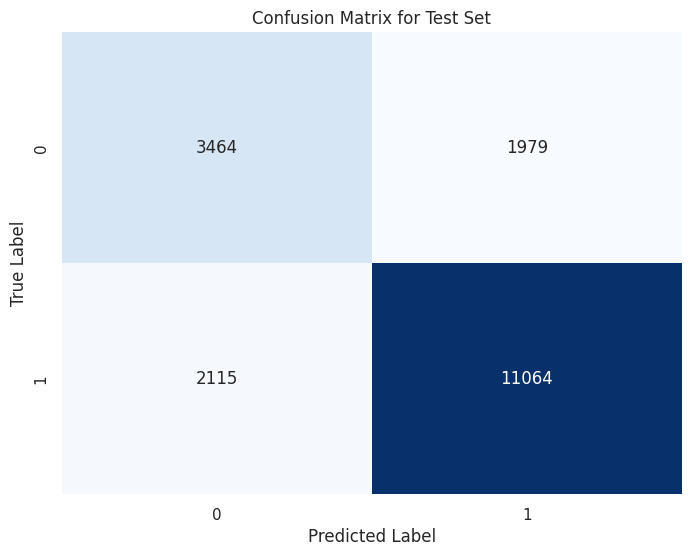

  param_clf__max_depth  param_clf__min_samples_split  \
0                    3                             2   
1                    3                             5   
2                    3                            10   
3                    3                             2   
4                    3                             5   

   param_clf__min_samples_leaf param_clf__criterion  mean_test_score  \
0                            1                 gini         0.702387   
1                            1                 gini         0.702387   
2                            1                 gini         0.702387   
3                            2                 gini         0.702387   
4                            2                 gini         0.702387   

   std_test_score  
0        0.027263  
1        0.027263  
2        0.027263  
3        0.027263  
4        0.027263  
Fitting 5 folds for each of 108 candidates, totalling 540 fits


/usr/local/lib/python3.12/dist-packages/xgboost/core.py:158: UserWarning: [01:27:47] WARNING: /home/coder/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.12/dist-packages/xgboost/core.py:158: UserWarning: [01:27:47] WARNING: /home/coder/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.12/dist-packages/xgboost/core.py:158: UserWarning: [01:27:47] WARNING: /home/coder/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.12/dist-packages/xgboost/core.py:158: UserWarning: [01:27:47] WARNING: /home/coder/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.12/dist-packages/xgboost/core.py:158: UserWarning: [01:27:47] WARNING: /home/coder/xgboost/sr


=== Best Parameters Found ===
{'colsample_bytree': 1.0, 'learning_rate': 0.2, 'max_depth': 7, 'n_estimators': 200, 'subsample': 1.0}

Best cross-validation f1_weighted score: 0.8287

=== Evaluation on Train Set ===
              precision    recall  f1-score   support

           0     0.8664    0.7370    0.7965     21667
           1     0.8983    0.9534    0.9250     52817

    accuracy                         0.8904     74484
   macro avg     0.8824    0.8452    0.8608     74484
weighted avg     0.8890    0.8904    0.8876     74484


=== Evaluation on Test Set ===
              precision    recall  f1-score   support

           0     0.7618    0.6199    0.6835      5443
           1     0.8542    0.9199    0.8859     13179

    accuracy                         0.8322     18622
   macro avg     0.8080    0.7699    0.7847     18622
weighted avg     0.8272    0.8322    0.8267     18622


--- Summary ---
Train F1-Score: 0.8876
Test F1-Score:  0.8267


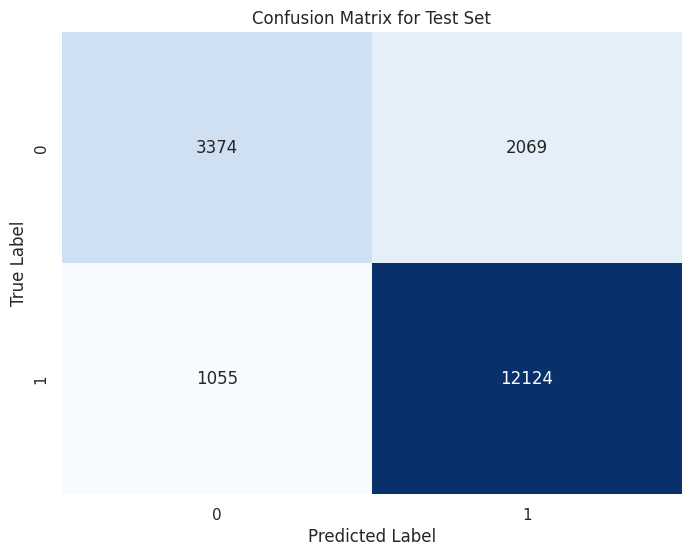

   param_clf__n_estimators  param_clf__max_depth  param_clf__learning_rate  \
0                       50                     3                      0.01   
1                       50                     3                      0.01   
2                      100                     3                      0.01   
3                      100                     3                      0.01   
4                      200                     3                      0.01   

   mean_test_score  std_test_score  
0         0.644753        0.002253  
1         0.644406        0.002094  
2         0.665912        0.001662  
3         0.665853        0.002736  
4         0.709071        0.000745  
Fitting 5 folds for each of 12 candidates, totalling 60 fits


ValueError: 
All the 60 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
60 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/sklearn/model_selection/_validation.py", line 866, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.12/dist-packages/sklearn/base.py", line 1389, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/sklearn/pipeline.py", line 654, in fit
    Xt = self._fit(X, y, routed_params, raw_params=params)
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/sklearn/pipeline.py", line 562, in _fit
    self._validate_steps()
  File "/usr/local/lib/python3.12/dist-packages/sklearn/pipeline.py", line 339, in _validate_steps
    raise TypeError(
TypeError: All intermediate steps should be transformers and implement fit and transform or be the string 'passthrough' 'SMOTE(random_state=42)' (type <class 'imblearn.over_sampling._smote.base.SMOTE'>) doesn't


In [29]:
%load_ext cuml.accel
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from joblib import dump, load
from typing import Any, Dict, Optional

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import StandardScaler
# from imblearn.pipeline import Pipeline # Sử dụng pipeline của imblearn để tích hợp sampler
from sklearn.pipeline import Pipeline

class ModelTuner:
    """
    Một lớp để tự động hóa việc tìm kiếm siêu tham số, huấn luyện và đánh giá mô hình.

    Bao gồm các bước:
    1. Xây dựng pipeline với tùy chọn sampler (để xử lý mất cân bằng) và scaler.
    2. Tìm kiếm siêu tham số tốt nhất bằng GridSearchCV.
    3. Đánh giá mô hình trên các tập dữ liệu khác nhau.
    4. Cung cấp các công cụ hỗ trợ như vẽ confusion matrix, lưu/tải mô hình.
    """
    def __init__(self, model: Any, param_grid: Dict, sampler: Optional[Any] = None, scoring: str = 'f1_weighted', cv: int = 5):
        """
        Khởi tạo ModelTuner.

        Args:
            model (Any): Một estimator của scikit-learn (ví dụ: LogisticRegression()).
            param_grid (Dict): Dictionary chứa các siêu tham số để tìm kiếm.
            sampler (Optional[Any], optional): Một sampler từ imblearn (ví dụ: SMOTE()). Mặc định là None.
            scoring (str, optional): Metric để tối ưu hóa. Mặc định là 'f1'.
            cv (int, optional): Số fold cho cross-validation. Mặc định là 5.
            n_jobs (int, optional): Số job chạy song song. -1 là dùng tất cả core. Mặc định là -1.
        """
        self.model = model
        self.param_grid = param_grid
        self.sampler = sampler
        self.scoring = scoring
        self.cv = cv
        
        self.best_estimator_: Optional[Pipeline] = None
        self.grid_search_: Optional[GridSearchCV] = None
        self.train_results_: Optional[Dict] = None
        self.test_results_: Optional[Dict] = None

    def fit(self, X_train: pd.DataFrame, y_train: pd.Series):
        """
        Huấn luyện mô hình sử dụng GridSearchCV.
        """
        steps = []
        if self.sampler:
            steps.append(('sampler', self.sampler))
        steps.append(('scaler', StandardScaler()))
        steps.append(('clf', self.model))
        
        pipe = Pipeline(steps)

        # Thêm tiền tố 'clf__' vào các key trong param_grid
        grid_params = {'clf__' + k: v for k, v in self.param_grid.items()}

        grid = GridSearchCV(
            estimator=pipe,
            param_grid=grid_params,
            scoring=self.scoring,
            cv=self.cv,
            verbose=1
        )
        grid.fit(X_train, y_train)

        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_

        print("\n=== Best Parameters Found ===")
        best_params_cleaned = {k.replace('clf__', ''): v for k, v in grid.best_params_.items()}
        print(best_params_cleaned)
        print(f"\nBest cross-validation {self.scoring} score: {grid.best_score_:.4f}")
        return self # <-- self, cho phép chaining

    def evaluate(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Đánh giá mô hình trên một tập dữ liệu cụ thể.

        Args:
            X (pd.DataFrame): Dữ liệu features.
            y (pd.Series): Dữ liệu target.
            dataset_name (str, optional): Tên của tập dữ liệu (ví dụ: 'Train', 'Test').

        Returns:
            Dict: Một dictionary chứa các metric đánh giá.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please call .fit() first.")

        y_pred = self.best_estimator_.predict(X)

        print(f"\n=== Evaluation on {dataset_name} Set ===")
        print(classification_report(y, y_pred, digits=4))

        results = {
            "accuracy": accuracy_score(y, y_pred),
            "precision": precision_score(y, y_pred, average='weighted'),
            "recall": recall_score(y, y_pred, average='weighted'),
            "f1": f1_score(y, y_pred, average='weighted')
        }
        return results

    def evaluate_train_test(self, X_train: pd.DataFrame, y_train: pd.Series, X_test: pd.DataFrame, y_test: pd.Series):
        """
        Một hàm tiện ích để đánh giá trên cả tập train và test.
        """
        self.train_results_ = self.evaluate(X_train, y_train, dataset_name='Train')
        self.test_results_ = self.evaluate(X_test, y_test, dataset_name='Test')
        
        print("\n--- Summary ---")
        print(f"Train F1-Score: {self.train_results_['f1']:.4f}")
        print(f"Test F1-Score:  {self.test_results_['f1']:.4f}")

    def plot_confusion_matrix(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Vẽ confusion matrix cho một tập dữ liệu.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Model has not been fitted yet. Please call .fit() first.")
        
        y_pred = self.best_estimator_.predict(X)
        cm = confusion_matrix(y, y_pred)
        
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix for {dataset_name} Set')
        plt.show()

    def get_cv_results_df(self) -> Optional[pd.DataFrame]:
        """
        Lấy kết quả cross-validation từ GridSearchCV và chuyển thành DataFrame.
        """
        if self.grid_search_ is None:
            print("GridSearchCV has not been run. Please call .fit() first.")
            return None
        return pd.DataFrame(self.grid_search_.cv_results_)

    def save_model(self, filepath: str):
        """
        Lưu mô hình tốt nhất (toàn bộ pipeline) vào một file.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("No best estimator to save. Please call .fit() first.")
        dump(self.best_estimator_, filepath)
        print(f"Model saved to {filepath}")

    @staticmethod   
    def load_model(filepath: str) -> Pipeline:
        """
        Tải một mô hình từ file.
        """
        model = load(filepath)
        print(f"Model loaded from {filepath}")
        return model
    

from imblearn.over_sampling import SMOTE

from sklearn.tree import DecisionTreeClassifier

model = DecisionTreeClassifier(random_state=42)
param_grid = {
    'max_depth': [3, 5, 7, 10, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'criterion': ['gini', 'entropy']
}

tuner = ModelTuner(model=model, param_grid=param_grid)

# Huấn luyện và đánh giá
tuner.fit(X_train, y_train)
tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

cv_results = tuner.get_cv_results_df()
if cv_results is not None:
    print(cv_results[['param_clf__max_depth', 'param_clf__min_samples_split', 
                      'param_clf__min_samples_leaf', 'param_clf__criterion', 
                      'mean_test_score', 'std_test_score']].head())
    
from xgboost import XGBClassifier

model = XGBClassifier(
    use_label_encoder=False,
    eval_metric='logloss', 
    random_state=42
)
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0]
}

tuner = ModelTuner(model=model, param_grid=param_grid)

# Huấn luyện và đánh giá
tuner.fit(X_train, y_train)
tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

cv_results = tuner.get_cv_results_df()
if cv_results is not None:
    print(cv_results[['param_clf__n_estimators', 'param_clf__max_depth', 
                      'param_clf__learning_rate', 'mean_test_score', 'std_test_score']].head())
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from imblearn.over_sampling import SMOTE

# Base estimator là Decision Tree nông
base_dt = DecisionTreeClassifier(max_depth=1, random_state=42)

model = AdaBoostClassifier(
    random_state=42
)

param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.5, 1.0]
}

tuner = ModelTuner(
    model=model,
    param_grid=param_grid,
    sampler=SMOTE(random_state=42)  # dùng SMOTE để xử lý imbalance
)

# Huấn luyện và đánh giá
tuner.fit(X_train, y_train)
tuner.evaluate_train_test(X_train, y_train, X_test, y_test)
tuner.plot_confusion_matrix(X_test, y_test, dataset_name='Test')

# Xem kết quả cross-validation
cv_results = tuner.get_cv_results_df()
if cv_results is not None:
    print(cv_results[['param_clf__n_estimators', 'param_clf__learning_rate', 'mean_test_score', 'std_test_score']].head())



In [ ]:
! pip show cuml
! pip show pylibraft

Name: cuml
Version: 25.4.0
Summary: cuML - RAPIDS ML Algorithms
Home-page: https://github.com/rapidsai/cuml
Author: NVIDIA Corporation
Author-email: 
License: Apache-2.0
Location: /usr/local/lib/python3.12/dist-packages
Requires: cuda-python, cudf, cupy-cuda12x, cuvs, dask-cuda, dask-cudf, joblib, libcuml, numba, numpy, packaging, pylibraft, raft-dask, rapids-dask-dependency, rmm, scipy, treelite
Required-by: 
Name: pylibraft
Version: 25.4.0
Summary: RAFT: Reusable Algorithms Functions and other Tools
Home-page: https://github.com/rapidsai/raft
Author: NVIDIA Corporation
Author-email: 
License: Apache 2.0
Location: /usr/local/lib/python3.12/dist-packages
Requires: cuda-python, libraft, numpy, rmm
Required-by: cugraph, cuml, cuvs, pylibcugraph, raft-dask



--extra-index-url https://pypi.nvidia.com
cuml-cu12==25.04.*
cudf-cu12==25.04.*
cugraph-cu12==25.04.*
dask-cuda==25.04.*
dask-cudf-cu12==25.04.*
raft-dask-cu12==25.04.*

In [ ]:
%load_ext cuml.accel
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from typing import Any, Dict, Optional
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from joblib import dump, load
from imblearn.pipeline import Pipeline as ImbPipeline

class AdvancedModelTuner:
    """
    Pipeline chuẩn cho ML experiment:
    - ColumnTransformer input sẵn
    - Tùy chọn sampler (SMOTE/ADASYN)
    - GridSearchCV tuning
    - In data đã xử lý, metrics, confusion matrix
    - Vẽ feature importance nếu có
    """
    def __init__(self, 
                 model: Any, 
                 param_grid: Dict, 
                 preprocessor: Any, 
                 sampler: Optional[Any] = None, 
                 scoring: str = 'f1_weighted', 
                 cv: int = 5, 
                 n_jobs: int = -1):
        self.model = model
        self.param_grid = param_grid
        self.preprocessor = preprocessor
        self.sampler = sampler
        self.scoring = scoring
        self.cv = cv
        self.n_jobs = n_jobs

        self.pipeline: Optional[Pipeline] = None
        self.grid_search_: Optional[GridSearchCV] = None
        self.best_estimator_: Optional[Pipeline] = None
        self.train_results_: Optional[Dict] = None
        self.test_results_: Optional[Dict] = None

    def fit(self, X_train: pd.DataFrame, y_train: pd.Series):
        """
        Build pipeline, fit GridSearchCV, show sample processed data.
        """
        steps = [('preprocessor', self.preprocessor)]
        if self.sampler:
            steps.append(('sampler', self.sampler))
        steps.append(('clf', self.model))

        self.pipeline = ImbPipeline(steps)
        
        # Grid search prep
        grid_params = {'clf__' + k: v for k, v in self.param_grid.items()}
        grid = GridSearchCV(
            estimator=self.pipeline,
            param_grid=grid_params,
            scoring=self.scoring,
            cv=self.cv,
            n_jobs=self.n_jobs,
            verbose=1
        )
        grid.fit(X_train, y_train)
        self.grid_search_ = grid
        self.best_estimator_ = grid.best_estimator_

        # Hiển thị thông tin
        print("\n=== Best Parameters ===")
        print({k.replace('clf__',''):v for k,v in grid.best_params_.items()})
        print(f"Best CV {self.scoring}: {grid.best_score_:.4f}")

        # Show processed data (1-2 batch)
        X_processed = self.preprocessor.transform(X_train)
        if isinstance(X_processed, pd.DataFrame):
            display(X_processed.head())
            print(X_processed.describe())
        else:
            # Nếu output là np.array
            print(pd.DataFrame(X_processed).head())
            print(pd.DataFrame(X_processed).describe())

        return self

    def evaluate(self, X: pd.DataFrame, y: pd.Series, dataset_name: str = 'Test'):
        """
        Metrics + classification report.
        """
        if self.best_estimator_ is None:
            raise RuntimeError("Call fit() first.")
        y_pred = self.best_estimator_.predict(X)
        print(f"\n=== Evaluation on {dataset_name} ===")
        print(classification_report(y, y_pred, digits=4))
        results = {
            "accuracy": accuracy_score(y, y_pred),
            "precision": precision_score(y, y_pred, average='weighted'),
            "recall": recall_score(y, y_pred, average='weighted'),
            "f1": f1_score(y, y_pred, average='weighted')
        }
        return results

    def evaluate_train_test(self, X_train, y_train, X_test, y_test):
        self.train_results_ = self.evaluate(X_train, y_train, 'Train')
        self.test_results_ = self.evaluate(X_test, y_test, 'Test')
        print(f"\n--- Summary ---")
        print(f"Train F1: {self.train_results_['f1']:.4f}")
        print(f"Test F1:  {self.test_results_['f1']:.4f}")

    def plot_confusion_matrix(self, X, y, dataset_name='Test'):
        y_pred = self.best_estimator_.predict(X)
        cm = confusion_matrix(y, y_pred)
        plt.figure(figsize=(8,6))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title(f'Confusion Matrix - {dataset_name}')
        plt.show()

    def plot_feature_importance(self):
        """
        Vẽ feature importance nếu model có .feature_importances_ hoặc .coef_
        """
        model = self.best_estimator_.named_steps['clf']
        try:
            if hasattr(model, 'feature_importances_'):
                importances = model.feature_importances_
            elif hasattr(model, 'coef_'):
                importances = model.coef_.ravel()
            else:
                print("Model không có feature_importances_ hoặc coef_")
                return
            # Lấy tên feature từ preprocessor
            feature_names = []
            for name, trans, cols in self.preprocessor.transformers_:
                if hasattr(trans, 'named_steps'):
                    # Pipeline trong ColumnTransformer
                    last_step = list(trans.named_steps.values())[-1]
                    if hasattr(last_step, 'get_feature_names_out'):
                        feature_names.extend(last_step.get_feature_names_out(cols))
                    else:
                        feature_names.extend(cols)
                else:
                    feature_names.extend(cols)
            df = pd.DataFrame({'feature': feature_names, 'importance': importances})
            df = df.sort_values('importance', ascending=False)
            plt.figure(figsize=(10,6))
            sns.barplot(data=df.head(20), x='importance', y='feature')
            plt.title('Top 20 Feature Importances')
            plt.show()
        except Exception as e:
            print("Error plotting feature importance:", e)

    def get_cv_results_df(self):
        if self.grid_search_ is None:
            print("GridSearchCV chưa chạy.")
            return None
        return pd.DataFrame(self.grid_search_.cv_results_)

    def save_pipeline(self, filepath: str):
        if self.best_estimator_ is None:
            raise RuntimeError("Fit trước khi lưu pipeline.")
        dump(self.best_estimator_, filepath)
        print(f"Pipeline saved to {filepath}")

    @staticmethod
    def load_pipeline(filepath: str):
        pipeline = load(filepath)
        print(f"Pipeline loaded from {filepath}")
        return pipeline


The cuml.accel extension is already loaded. To reload it, use:
  %reload_ext cuml.accel


In [ ]:
import torch

# Check if CUDA is available
cuda_available = torch.cuda.is_available()
print(f"Is CUDA available? {cuda_available}")

if cuda_available:
    # Print the CUDA version PyTorch was compiled with
    print(f"PyTorch CUDA version: {torch.version.cuda}")
    
    # Get the number of GPUs
    num_gpus = torch.cuda.device_count()
    print(f"Number of GPUs available: {num_gpus}")
    
    # Get the name of the current GPU
    current_gpu_name = torch.cuda.get_device_name(torch.cuda.current_device())
    print(f"Current GPU name: {current_gpu_name}")
else:
    print("CUDA is not available. PyTorch is running on CPU.")

Is CUDA available? True
PyTorch CUDA version: 12.9
Number of GPUs available: 1
Current GPU name: NVIDIA GeForce RTX 4050 Laptop GPU


In [ ]:
!nvidia-smi

Sun Sep 21 18:32:06 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 580.82.09              Driver Version: 580.82.09      CUDA Version: 13.0     |
+-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4050 ...    Off |   00000000:01:00.0 Off |                  N/A |
| N/A   51C    P8              3W /   60W |    1557MiB /   6141MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----